# ADRL Assignment 2 <br>
## Team:<br>
#### Anmol Anil Dhanuka (SR No: 21989)<br>
#### Sharath C R (SR No: 21744)<br>
#### Unity Chachei (SR No: 21916) <br>

# Problem2 - BiGAN with a Wasserstein's Loss

- BiGAN model is implemented on Pytorch
- Kaggle dataset for animal images used (Dataset has 16130 images of cats, dogs and wild animals)
- Objective:
    - Implement a BiGAN model with Wasserstein's Loss
    - Plot 10 by 10 grids of generated images
    - Plot images generated from interpolated latent vectors
    - Perform posterior inference and classify using a linear classifier and SVM classifier


## Import required Python libraries

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vutils
import torchvision
import torchvision.transforms as transforms
from mpl_toolkits.axes_grid1 import ImageGrid
import matplotlib.pyplot as plt
from tqdm import tqdm
from torch.autograd import Variable
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
%matplotlib inline

torch.autograd.set_detect_anomaly(True)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Loading data from the folders

- Compose a transform with:
    - Images resized to (3,128,128)
    - Convert images to Torch tensor
<br>
<br>        
        
- Load the images from the folder with a batch size of 100

In [ ]:
def load_dataset(batch_size = 100, total_len=False):
    transform = transforms.Compose(
        [
            transforms.Resize(size=128),
            transforms.ToTensor(),
            transforms.Normalize((0.5,0.5,0.5),(0.5,0.5,0.5))
        ]

    )
    #train_data = datasets.ImageFolder('/content/drive/MyDrive/ADRL Assignment/data/',transform=transform)
    train_data = datasets.ImageFolder('.\\archive\\afhq\\train\\',transform=transform)
    test_data = datasets.ImageFolder('.\\archive\\afhq\\val\\',transform=transform)

    if total_len:
        train_bsize = len(train_data)
        test_bsize = len(test_data)
    else:
        train_bsize = batch_size
        test_bsize = batch_size

    train_loader = DataLoader(train_data,batch_size=train_bsize,shuffle=True,num_workers=4)
    test_loader = DataLoader(test_data,batch_size=test_bsize,shuffle=True,num_workers=4)

    return train_loader, test_loader

# Critic/Discriminator Network

Wasserteins Loss function is used for training => Critic Network <br>


- Here Critic network does a classification between $x\hat{z}$ and $\hat{x}z$
- Optimum condition is attained when $P_{x\hat{z}}$ = $P_{\hat{x}z}$
- Separate networks used for x and z and then a joint network used (z network is smaller due to z being of much lower dimension than x)
    - The intermediate dimensions (After their individual network) of x and z are kept same so that the Critic trains properly for z as well
- The Critic Network here doesnt work as a classifier (doesnt output values in [0,1]) due to Wassersteins loss. Hence sigmoid activation layer not used at the end of network


In [ ]:
class Critic(nn.Module):
    '''
    H_out = ((H_in + 2*padding - dilation*(kernel_size-1) - 1)/stride) + 1
    '''
    def __init__(self, z_dim = 128):
        super(Critic, self).__init__()

        self.disc_x = nn.Sequential(
            # input is 3*128*128
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # input is 64*64*64
            nn.Conv2d(64, 64 * 2, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # input is 128*32*32
            nn.Conv2d(64 * 2, 64 * 4, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # input is 256*16*16
            nn.Conv2d(64 * 4, 64 * 8, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # input is 512*8*8
            nn.Conv2d(64 * 8, 64 * 16, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # input is 1024*4*4
            nn.Conv2d(64 * 16, 64 * 16, 4, 1, 0, bias=False),
            nn.LeakyReLU(0.2, inplace=True)
            # output is 1024*1*1


        )

        self.disc_z = nn.Sequential(
            # input is 100*1*1
            nn.Conv2d(z_dim, 512, 1, 1, 0),
            nn.LeakyReLU(0.2, inplace=True),
            # input is 512*1*1
            nn.Conv2d(512, 1024, 1, 1, 0),
            nn.LeakyReLU(0.2, inplace=True)
            # output is 1024*1*1
        )


        self.disc_xz = nn.Sequential(
            # input is (1024+1024)*1*1
            nn.Conv2d(2048, 4096, 1, 1, 0),
            nn.LeakyReLU(0.2, inplace=True),
            # input is 4096*1*1
            nn.Conv2d(4096, 4096, 1, 1, 0),
            nn.LeakyReLU(0.2, inplace=True),
            # input is 4096*1*1
            nn.Conv2d(4096, 1, 1, 1, 0)
            # output is 1*1*1
        )


    def forward(self, x,z):
        '''
        Performs the forward pass of the Critic
        Inputs: x (Images: Either generated or real images), z (Latent vectors: From a standard normal distribution or from encoder)
        Outputs a critic value not restricted to [0,1]
        '''
        x = self.disc_x(x)
        z = self.disc_z(z)
        xz = torch.cat((x,z), dim=1)
        out = self.disc_xz(xz)
        return out

# Generator Network

- Input: z $\sim$ N(0,I) ; Output: $\hat{x}$ = $g_{\theta}(z)$
- z $\epsilon$ $R^{100}$
- $\hat{x}$ $\epsilon$ $R^{3*128*128}$
- Objective of the generator is to minimize the probability of $\hat{x}$ not belonging to $p_{x}$
- Hence it generates images such that critic is not able to differentiate generated from true images
- Tanh activation is used at the end of the network to provide higher gradients during backpropogation (Tanh outputs in the range [-1,1] compared to sigmoid which outputs in the range [0,1])

In [ ]:
class Generator(nn.Module):

    def __init__(self, z_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        '''
        H_out = (H_in - 1)*stride - 2*padding + dilation*(kernel_size-1) + output_pad + 1
        Defaults:
           stride: 1
           padding: 0
           dilation: 1
        '''

        self.gen = nn.Sequential(
            # input is z_dim*1*1 (i.e. 100*1*1)
            nn.ConvTranspose2d(self.z_dim, 64 * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(64 * 16),
            nn.ReLU(True),
            # input is 1024*4*4
            nn.ConvTranspose2d(64 * 16, 64 * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 8),
            nn.ReLU(True),
            # input is 512*8*8
            nn.ConvTranspose2d( 64 * 8, 64 * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64 * 4),
            nn.ReLU(True),
            # input is 256*16*16
            nn.ConvTranspose2d( 64 * 4, 64*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64*2),
            nn.ReLU(True),
            # input is 128*32*32
            nn.ConvTranspose2d( 64*2, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(True),
            # input is 64*64*64
            nn.ConvTranspose2d(64,3, 4, 2, 1, bias=False),
            nn.Tanh()
            # output is 3*128*128
        )


    def forward(self, z):
        '''
        Performs the forward pass of the Generator
        Inputs:  z (Latent vectors: From a standard normal distribution)
        Outputs: Generated images (x_cap)
        '''
        # Change the shape: (batch_size, channels=z_dim, width=1, height=1)
        z = z.view(len(z), self.z_dim, 1, 1)
        return self.gen(z)

# Encoder Network

- Encoder:
    - Input: x (True images) ; Output: $\hat{z}$  (Encoded latent vectors)
- $\hat{z}$ $\epsilon$ $R^{100}$
- x $\epsilon$ $R^{3*128*128}$
- Objective of the encoder is to encode $\hat{z}$ from True images
- Optimum condition is attained when $P_{x\hat{z}}$ = $P_{\hat{x}z}$ => $P_{\hat{z}}$ = $P_{z}$ (Since marginal distribution is also same if joint distribution is same)

In [ ]:
class Encoder(nn.Module):

    def __init__(self, z_dim=64):
        super(Encoder, self).__init__()
        self.z_dim = z_dim
        '''
        H_out = ((H_in + 2*padding - dilation*(kernel_size-1) - 1)/stride) + 1
        '''

        self.enc = nn.Sequential(
            # input is 3*128*128
            nn.Conv2d(3, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            # input is 64*64*64
            nn.Conv2d(64, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            # input is 128*32*32
            nn.Conv2d(128, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            # input is 256*16*16
            nn.Conv2d(256, 512, 4, 2, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            # input is 512*8*8
            nn.Conv2d(512, 1024, 4, 2, 1, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(inplace=True),
            # input is 1024*4*4
            nn.Conv2d(1024, 1024, 4, 1, 0, bias=False),
            nn.BatchNorm2d(1024),
            nn.ReLU(inplace=True),
            # input is 1024*1*1
            nn.Conv2d(1024, self.z_dim, 1, 1)
            # output is z_dim*1*1 (i.e. 100*1*1) => Directly outputs the encoded latent vector
        )


    def forward(self, x):
        '''
        Performs the forward pass of the Encoder
        Inputs:  x (True images)
        Outputs: z_cap (Encoded Latent vectors)
        '''
        z = self.enc(x)
        return z.view(x.size(0), self.z_dim, 1, 1)

### Function to initialize the weights of networks

In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1 and classname != 'Conv':
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        #torch.nn.init.xavier_uniform_(m.weight.data)
        if m.bias is not None:
            m.bias.data.fill_(0)
    elif classname.find("Linear") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        #torch.nn.init.xavier_uniform_(m.weight.data)
        if m.bias is not None:
            m.bias.data.fill_(0)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.01)
        #torch.nn.init.xavier_uniform_(m.weight.data)
        if m.bias is not None:
            m.bias.data.fill_(0)

## Gradient Penalty - Optimization for stable training using WGAN loss

Generally WGAN involves the clipping of weights of Critic to ensure a 1-Lipschitz function required for WGAN loss

However, as per the WGAN paper [Ref: Wasserstein GAN - Martin Arjovsky,Soumith Chintala, L´eon Bottou],

"Weight clipping is a clearly terrible way to enforce a Lipschitz constraint. If the
clipping parameter is large, then it can take a long time for any weights to reach
their limit, thereby making it harder to train the critic till optimality. If the clipping
is small, this can easily lead to vanishing gradients when the number of layers is
big, or batch normalization is not used (such as in RNNs)"

There are some optimizations done in this regard where Gradient Penalty has been found to be effective <br>
 - The Gradient penalty method adds a penalty/strong regularization in the critic loss to ensure that the gradient norm is $\leq$ to 1
 - This is another way to ensure a 1-Lipschitz function
 - The advantage here is that Gradient penalty ensures a spread of weights (Preventing the problems mentioned in the paper) unlike weight clipping where there can be a condition with weights just being clipped values or close to clipped values (There is no spread of weights)


Critic Loss function = - mean($T_{w}(x\hat{z})$) + mean($T_{w}(\hat{x}z)$) + $\lambda$*gradient_penalty <br><br>
Where $\lambda$ is the regularization constant. Value used is = 10 <br>
Here mean() taken as a LLN approximation for samples of $x\hat{z}$ and $\hat{x}z$ from their respective distributions

Gradient_penalty = $\underset{\alpha \sim P_{\alpha}}{E}[(||\nabla{\alpha}f(\alpha)||_{2}-1)^{2}]$ <br>

Where $P_{\alpha}$ is the distribution obtained by uniformly sampling along a straight line between the real and generated distributions

In [ ]:
def calculate_gradient_penalty(model, x, x_cap, z_cap, z, device):
    """Calculates the gradient penalty loss for WGAN GP"""
    # Random weight term for interpolation between real and generated images
    alpha = torch.randn((x.size(0), 1, 1, 1), device=device)
    # Get random interpolation between real and generated images
    interpolates = (alpha * x + ((1 - alpha) * x_cap)).requires_grad_(True)
    interpolate_z = (alpha * z_cap + ((1 - alpha) * z)).requires_grad_(True)

    model_interpolates = model(interpolates,interpolate_z)
    grad_outputs = torch.ones(model_interpolates.size(), device=device, requires_grad=False)

    # Get gradient w.r.t. interpolates
    gradients = torch.autograd.grad(
        outputs=model_interpolates,
        inputs=(interpolates,interpolate_z),
        grad_outputs=grad_outputs,
        create_graph=True,
        retain_graph=True,
        only_inputs=True,
    )[0]
    gradients = gradients.view(gradients.size(0), -1)
    gradient_penalty = torch.mean((gradients.norm(2, dim=1) - 1) ** 2)
    return gradient_penalty

### Scale the images output from Generator for plotting

- Generator uses a Tanh() activation which outputs in the range [-1,1]
- Matplotlib's imshow() function requires the image inputs in the range [0,1]
- Hence we are scaling the Tanh() outputs to [0,1] by using the following scaling : x = 0.5*x + 0.5

In [ ]:
normalize = transforms.Compose([
    transforms.Lambda(lambda x: (x + 1) / 2)
     ])

# BiGAN + Wasserstein's loss Training

### Losses

Critic loss =  -$\underset{x\hat{z} \sim P_{x\hat{z}}}{E}(T_{w}(x\hat{z}))$ + $\underset{\hat{x}{z} \sim P_{\hat{x}{z}}}{E}(T_{w}(\hat{x}z))$ + $\lambda$*gradient_penalty <br><br>

Note:
- The above critic loss is actually negative of the critic loss. Generally we maximize the Critic loss across a class of 1-Lipschitz functions $T_{w_{L}}()$
- Given the above is negative of the loss, we will use the optimizer to minimize the loss
- In non Gradient penalty case, the Regularization term for gradient penalty is removed. Instead the updated weights for the Critic is clipped by a fixed value <br><br>



Generator-Encoder loss = $\underset{x\hat{z} \sim P_{x\hat{z}}}{E}(T_{w}(x\hat{z}))$ - $\underset{\hat{x}{z} \sim P_{\hat{x}{z}}}{E}(T_{w}(\hat{x}z))$ <br> <br>
The above ge_loss is minimized using Pytorch optimizers <br><br>

Note:
- For implementation we have used the LLN (Law of Large Numbers) approximation for the Expectations and taken the mean instead


In [ ]:

class BiGAN:
    def __init__(self,data_train, data_test, device, latent_dim,lr, epochs, clamp, critic_gen_ratio = 1, grad_penalty = False):

        self.latent_dim = latent_dim
        self.lr = lr
        self.train_loader = data_train
        self.test_loader = data_test
        self.device = device
        self.epochs = epochs
        self.clamp = clamp
        self.GP = grad_penalty
        self.critic_gen_ratio = critic_gen_ratio


    def train(self):
        '''
        Performs training of Critic, Generator and Encoder networks in batches of 100 images over multiple epochs
        '''

        # Lists defined to store the losses across epochs
        GE_loss_list = []
        D_loss_list = []

        # Create object of the Generator, Encoder and Critic Networks
        self.G = Generator(self.latent_dim).to(self.device)
        self.E = Encoder(self.latent_dim).to(self.device)
        self.D = Critic(self.latent_dim).to(self.device)

        # Apply weight and bias initializations to each network
        self.G.apply(weights_init_normal)
        self.E.apply(weights_init_normal)
        self.D.apply(weights_init_normal)

        # Alternative optimizer that can be used (Different from Adam in terms of using momentum)
        # optimizer_ge = optim.RMSprop(list(self.G.parameters()) + list(self.E.parameters()), lr=self.lr)
        # optimizer_d = optim.RMSprop(self.D.parameters(), lr=self.lr)

        # Adam optimizer used for current experiments
        optimizer_ge = optim.Adam(list(self.G.parameters()) + list(self.E.parameters()), lr=self.lr, betas=(0.5, 0.9))
        optimizer_d = optim.Adam(self.D.parameters(), lr=self.lr, betas=(0.5, 0.9))

        for epoch in range(self.epochs):
            ge_losses = 0
            d_losses = 0
            self.D.train()
            self.E.train()
            self.G.train()

            for batch_idx, (x,_) in tqdm(enumerate(self.train_loader),total=len(self.train_loader),colour='GREEN'):

                optimizer_d.zero_grad()
                #Generator: Generate random latent vectors (normally distributed) and forward pass through the generator network
                z = Variable(torch.randn((x.size(0), self.latent_dim, 1, 1)).to(self.device),requires_grad=False)
                x_cap = self.G(z)

                #Encoder: Use the True images and forward pass through encoder to get the encoded latent vectors
                x = x.float().to(self.device)
                z_cap = self.E(x)

                #Discriminator: Pass (x,z_cap) and (x_cap,z) through the discriminator/Critic Network
                x_z_cap = self.D(x, z_cap.detach())
                x_cap_z = self.D(x_cap.detach(), z)

                # Options provided to use Gradient Penalty vs Weight Clipping
                if self.GP :
                    gradient_penalty = calculate_gradient_penalty(self.D, x, x_cap.detach(), z_cap, z, self.device)
                    # Loss function for critic
                    loss_d = - torch.mean(x_z_cap) + torch.mean(x_cap_z) + 10*gradient_penalty
                    loss_d.backward(retain_graph=True)
                    optimizer_d.step()
                else:
                    loss_d = - torch.mean(x_z_cap) + torch.mean(x_cap_z)
                    loss_d.backward(retain_graph=True)
                    optimizer_d.step()
                    for p in self.D.parameters():
                        p.data.clamp_(-self.clamp, self.clamp)


                # Critic_gen_ratio controls the number of times Critic network parameters are updated before Generator-Encoder parameters updated
                # Critic_gen_ratio = 1 was found to have better performance
                if epoch % self.critic_gen_ratio == 0:
                    optimizer_ge.zero_grad()
                    x_z_cap = self.D(x, z_cap)
                    x_cap_z = self.D(x_cap, z)
                    # Combined loss function for encoder and Generator
                    loss_ge = - torch.mean(x_cap_z) + torch.mean(x_z_cap)

                    loss_ge.backward()
                    optimizer_ge.step()

                ge_loss = loss_ge.item()
                d_loss = loss_d.item()

                ge_losses += ge_loss
                d_losses += d_loss

            GE_loss_list.append(ge_loss)
            D_loss_list.append(d_loss)



            print('Epoch [{}/{}], Avg_Loss_D: {:.4f}, Avg_Loss_EG: {:.4f}'.format(epoch + 1, self.epochs, d_losses/len(self.train_loader), ge_losses*self.critic_gen_ratio/len(self.train_loader)))

            # Save state dictionary every 50 epochs
            if (epoch+1) % 50 == 0:
                torch.save({
                'D_state_dict': self.D.state_dict(),
                'G_state_dict': self.G.state_dict(),
                'E_state_dict': self.E.state_dict(),
                'optimizer_D_state_dict': optimizer_d.state_dict(),
                'optimizer_EG_state_dict': optimizer_ge.state_dict(),
                }, '.\models_state_dict_bi_gan_{}.tar'.format(epoch+1))

        self.D.eval()
        self.E.eval()
        self.G.eval()

        # Plot the generated and reconstructed images
        self.plots(title=f'Generated images : G(z), Epochs: {epoch + 1}',encoded_latent = False)
        self.plots(title=f'Reconstructed images: G(E(x)), Epochs: {epoch + 1}',encoded_latent = True)

        #self.interpolate_plot(title=f'Generated images, Interpolated z, Epochs: {epoch}',encoded_latent = False)
        #self.interpolate_plot(title=f'Generated images, Interpolated z_cap, Epochs: {epoch}',encoded_latent = True)

        return GE_loss_list, D_loss_list


    def plots(self, title, encoded_latent = False):
        '''
        Plots the Generated and reconstucted images. Reconstructed images plotted if Encoded_latent = True
        '''
        with torch.no_grad():
            images,_ = next(iter(self.train_loader))
            images = images.to(device)

            if encoded_latent:
                z_int = self.E(images)
            else:
                z_int = Variable(torch.randn((images.size(0), self.latent_dim, 1, 1)).to(device),requires_grad=False)


            z_int = z_int.to(device)
            x_cap = self.G(z_int)
            x_cap = x_cap.detach().cpu()
            x_cap = normalize(x_cap)
            fig = plt.figure(figsize=(12, 12))
            grid = ImageGrid(fig, 111, nrows_ncols=(10, 10), axes_pad=0.05)


            for ax, im in zip(grid, x_cap):
                ax.imshow(im.permute(1,2,0))
                ax.axis('off')

            fig.suptitle(title)
            plt.show()

    def interpolate_plot(self, title, num_interpolates = 10, num_z = 10, encoded_latent = False):
        '''
        Performs a linear interpolation between pairs of latent vectors and plots the num_interpolates number of images of each pair
        The latent vector pairs can be either normally distributed OR Encoded Latent vectors based on the encoded_latent field
        '''

        with torch.no_grad():
            images,_ = next(iter(self.train_loader))
            images = images.to(device)

            if encoded_latent:
                z1 = self.E(images[0:num_z])
                z2 = self.E(images[10:10+num_z])
            else:
                z1 = Variable(torch.randn((num_z, self.latent_dim, 1, 1)).to(device),requires_grad=False)
                z2 = Variable(torch.randn((num_z, self.latent_dim, 1, 1)).to(device),requires_grad=False)

            alphas = torch.linspace(0, 1, num_interpolates)
            alphas = alphas.to(device)
            x_int = []
            for alpha in alphas:
                z_int = alpha*z1 + (1 - alpha)*z2
                x = normalize(self.G(z_int).detach())
                x_int.append(x)


            x_int = torch.cat(x_int, dim=1).view(-1, 3, 128, 128)
            x_int = x_int.cpu()
            fig = plt.figure(figsize=(12, 12))
            grid = ImageGrid(fig, 111, nrows_ncols=(num_z, num_interpolates), axes_pad=0.05)


            for ax, im in zip(grid, x_int):
                ax.imshow(im.permute(1,2,0))
                ax.axis('off')

            fig.suptitle(title)
            plt.show()


    def Load_state(self,filepath):
        '''
        Loads the state dictionary (for the particular epoch)
        '''
        checkpoint = torch.load(filepath)
        self.G.load_state_dict(checkpoint['G_state_dict'])
        self.E.load_state_dict(checkpoint['E_state_dict'])
        self.D.load_state_dict(checkpoint['D_state_dict'])
        return self.G,self.E,self.D

    def plot_loss_curves(self,ge_loss, d_loss):
        '''
        Plots the G-E loss and Critic loss across epochs
        '''
        len_ = len(ge_loss)
        plt.plot(range(1,len_+1),ge_loss, color='r', label='GE_loss')
        plt.plot(range(1,len_+1),d_loss, color='b', label='Critic_Loss')
        plt.xticks(torch.linspace(0,len_,int(len_/10),dtype=int),rotation=90)
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.title("BiGAN with Wassersteins Loss vs epochs")
        plt.legend()
        plt.grid()
        plt.show()


    def post_inference(self,classifier='SVM',SVM_kernel = 'rbf', pca=True, pca_components=30):
        '''
        Performs posterior inference by Encoding the True images and then classifying them using SVM or Linear classifier
        Accepts following parameters:
            1. Classifier : SVM or Linear
            2. kernel: Kernel for SVM classifier
            3. PCA: Whether PCA is required on the encoded latent vectors
            4. pca_components: Number of components of PCA if PCA is required
        '''
        with torch.no_grad():
            scale = StandardScaler()
            # Run the encoding in batches for lesser memory utilization
            for batch_idx, (x_train,y_train) in tqdm(enumerate(self.train_loader),total=len(self.train_loader),colour='GREEN'):
                x_train = x_train.to(device)
                z_enc = self.E(x_train)

                z_enc = z_enc.detach().cpu().squeeze()

                if batch_idx == 0:
                    z_total = z_enc
                    y_total = y_train
                    x_train1 = x_train.detach().cpu()
                else:
                    z_total = torch.cat((z_total,z_enc),dim=0)
                    y_total = torch.cat((y_total,y_train),dim=0)

            # Perform standard scaling of the encoded latent vectors
            z_total = scale.fit_transform(z_total)

            # Run PCA if PCA option is true
            if pca:
                pca=PCA(n_components=pca_components)
                z_total = pca.fit_transform(z_total)

            # Perform fitting based on the classifier chosen
            if classifier == 'SVM':
                if SVM_kernel == 'rbf':
                    svc_clf = SVC(kernel=SVM_kernel, C=1, gamma=0.001, max_iter=1000)
                else:
                    svc_clf = SVC(kernel=SVM_kernel, C=0.1, max_iter=1000)
                svc_clf.fit(z_total,y_total)
                train_predict = svc_clf.predict(z_total)
            else:
                clf = LogisticRegression(random_state=0, penalty='l2')
                clf.fit(z_total,y_total)
                train_predict = clf.predict(z_total)

            # Calculate the train accuracy score
            train_accuracy = accuracy_score(y_total,train_predict)
            print(f'Train Accuracy: {train_accuracy}')

            # Plot 10 images with their classifications
            fig = plt.figure(figsize=(15, 2))
            grid = ImageGrid(fig, 111, nrows_ncols=(1, 10), axes_pad=0.25)

            i = 0
            x_train1 = normalize(x_train1)
            for ax, im in zip(grid, x_train1[0:10]):
                ax.imshow(im.permute(1,2,0))
                ax.axis('off')
                ax.set_title(f'Class:{y_total[i]}, {classifier}:{train_predict[i]}')
                i = i + 1

            fig.suptitle(f'{classifier} Train inference')
            fig.tight_layout()
            plt.show()

            # Everything repeated with test data except for fitting of SVM or linear models
            for batch_idx, (x_test,y_test) in tqdm(enumerate(self.test_loader),total=len(self.test_loader),colour='GREEN'):
                x_test = x_test.to(device)
                z_enc_test = self.E(x_test)

                z_enc_test = z_enc_test.detach().cpu().squeeze()
                if batch_idx == 0:
                    z_total_test = z_enc_test
                    y_total_test = y_test
                    x_test1 = x_test.detach().cpu()
                else:
                    z_total_test = torch.cat((z_total_test,z_enc_test),dim=0)
                    y_total_test = torch.cat((y_total_test,y_test),dim=0)


            z_total_test = scale.fit_transform(z_total_test)
            if pca:
                z_total_test = pca.fit_transform(z_total_test)

            if classifier == 'SVM':
                test_predict = svc_clf.predict(z_total_test)
            else:
                test_predict = clf.predict(z_total_test)


            test_accuracy = accuracy_score(y_total_test,test_predict)
            print(f'Test Accuracy: {test_accuracy}')

            fig2 = plt.figure(figsize=(15, 2))
            grid2 = ImageGrid(fig2, 111, nrows_ncols=(1, 10), axes_pad=0.25)

            i = 0
            x_test1 = normalize(x_test1)
            for ax, im in zip(grid2, x_test1[0:10]):
                ax.imshow(im.permute(1,2,0))
                ax.axis('off')
                ax.set_title(f'Class:{y_total_test[i]}, {classifier}:{test_predict[i]}')
                i = i + 1

            fig2.suptitle(f'{classifier} Test inference')
            fig2.tight_layout()
            plt.show()





# Experiment 1  -  Training with Gradient Penalty

- Gradient penalty approach used
- Parameters:
    - Epochs : 200
    - Learning rate: 1e-4
    - Latent dimensions: 100
    - Critic to Gen-Encoder training ratio : 1

Note: The clamping/clipping value can be ignored since Gradient penalty is used

### Observations:

- Gradient penalty method performs better than the Weight clipping method (Experiment 2)
- After running multiple cases of "Critic to Gen-Encoder training ratio", the optimal value for this parameter was found to be 1
    - This observation depends on the networks declared for Critic, Generator and Encoder. If Generator-Encoder networks are stronger than Critic, higher values for "Critic to Gen-Encoder training ratio" might help
- Higher learning rates was found to give more variations in Losses. Ended up taking more time to converge
- The ge_losses start to increase as the epochs go higher. Need to run more experiments on this

100%|██████████| 147/147 [00:46<00:00,  3.14it/s]


Epoch [1/200], Avg_Loss_D: -182.5909, Avg_Loss_EG: 329.2413


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [2/200], Avg_Loss_D: -43.2590, Avg_Loss_EG: 83.7669


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [3/200], Avg_Loss_D: -38.8685, Avg_Loss_EG: 71.8034


100%|██████████| 147/147 [00:44<00:00,  3.29it/s]


Epoch [4/200], Avg_Loss_D: -30.3499, Avg_Loss_EG: 57.4088


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [5/200], Avg_Loss_D: -23.8274, Avg_Loss_EG: 47.2548


100%|██████████| 147/147 [00:44<00:00,  3.28it/s]


Epoch [6/200], Avg_Loss_D: -23.2204, Avg_Loss_EG: 44.7045


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [7/200], Avg_Loss_D: -18.3313, Avg_Loss_EG: 36.2391


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [8/200], Avg_Loss_D: -16.6003, Avg_Loss_EG: 32.5540


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [9/200], Avg_Loss_D: -16.7201, Avg_Loss_EG: 31.8374


100%|██████████| 147/147 [00:44<00:00,  3.29it/s]


Epoch [10/200], Avg_Loss_D: -15.3198, Avg_Loss_EG: 29.7213


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [11/200], Avg_Loss_D: -13.5070, Avg_Loss_EG: 26.1836


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [12/200], Avg_Loss_D: -11.8747, Avg_Loss_EG: 23.0988


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [13/200], Avg_Loss_D: -11.7878, Avg_Loss_EG: 22.9428


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [14/200], Avg_Loss_D: -11.4889, Avg_Loss_EG: 22.0028


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [15/200], Avg_Loss_D: -10.5926, Avg_Loss_EG: 20.5877


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [16/200], Avg_Loss_D: -9.7287, Avg_Loss_EG: 18.8473


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [17/200], Avg_Loss_D: -9.9284, Avg_Loss_EG: 18.7069


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [18/200], Avg_Loss_D: -9.0862, Avg_Loss_EG: 17.2924


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [19/200], Avg_Loss_D: -9.4100, Avg_Loss_EG: 17.6121


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [20/200], Avg_Loss_D: -8.9789, Avg_Loss_EG: 16.9689


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [21/200], Avg_Loss_D: -9.1399, Avg_Loss_EG: 16.8099


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [22/200], Avg_Loss_D: -9.3189, Avg_Loss_EG: 16.6052


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [23/200], Avg_Loss_D: -9.4422, Avg_Loss_EG: 16.7955


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [24/200], Avg_Loss_D: -9.6143, Avg_Loss_EG: 16.7646


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [25/200], Avg_Loss_D: -9.4635, Avg_Loss_EG: 16.7264


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [26/200], Avg_Loss_D: -9.4472, Avg_Loss_EG: 16.2124


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [27/200], Avg_Loss_D: -9.1267, Avg_Loss_EG: 15.7782


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [28/200], Avg_Loss_D: -9.0072, Avg_Loss_EG: 15.4793


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [29/200], Avg_Loss_D: -8.9625, Avg_Loss_EG: 15.4583


100%|██████████| 147/147 [00:44<00:00,  3.29it/s]


Epoch [30/200], Avg_Loss_D: -8.5124, Avg_Loss_EG: 14.7893


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [31/200], Avg_Loss_D: -8.6574, Avg_Loss_EG: 14.7287


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [32/200], Avg_Loss_D: -8.5078, Avg_Loss_EG: 14.5067


100%|██████████| 147/147 [00:44<00:00,  3.29it/s]


Epoch [33/200], Avg_Loss_D: -8.4475, Avg_Loss_EG: 14.5948


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [34/200], Avg_Loss_D: -8.3902, Avg_Loss_EG: 14.5877


100%|██████████| 147/147 [00:44<00:00,  3.29it/s]


Epoch [35/200], Avg_Loss_D: -8.3851, Avg_Loss_EG: 14.2436


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [36/200], Avg_Loss_D: -8.2005, Avg_Loss_EG: 14.0663


100%|██████████| 147/147 [00:44<00:00,  3.28it/s]


Epoch [37/200], Avg_Loss_D: -7.9063, Avg_Loss_EG: 13.6760


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [38/200], Avg_Loss_D: -7.8405, Avg_Loss_EG: 13.4680


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [39/200], Avg_Loss_D: -7.6900, Avg_Loss_EG: 13.2529


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [40/200], Avg_Loss_D: -7.6228, Avg_Loss_EG: 13.3424


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [41/200], Avg_Loss_D: -7.4357, Avg_Loss_EG: 12.9675


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [42/200], Avg_Loss_D: -7.2628, Avg_Loss_EG: 12.4876


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [43/200], Avg_Loss_D: -7.1351, Avg_Loss_EG: 12.3447


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [44/200], Avg_Loss_D: -7.0946, Avg_Loss_EG: 12.2969


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [45/200], Avg_Loss_D: -7.0590, Avg_Loss_EG: 12.1312


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [46/200], Avg_Loss_D: -6.9277, Avg_Loss_EG: 12.1707


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [47/200], Avg_Loss_D: -6.9938, Avg_Loss_EG: 12.1883


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [48/200], Avg_Loss_D: -6.8583, Avg_Loss_EG: 12.0236


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [49/200], Avg_Loss_D: -6.9860, Avg_Loss_EG: 12.0919


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [50/200], Avg_Loss_D: -6.9767, Avg_Loss_EG: 12.2348


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [51/200], Avg_Loss_D: -7.0239, Avg_Loss_EG: 12.1868


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [52/200], Avg_Loss_D: -6.8630, Avg_Loss_EG: 11.7661


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [53/200], Avg_Loss_D: -6.9191, Avg_Loss_EG: 12.0847


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [54/200], Avg_Loss_D: -6.9532, Avg_Loss_EG: 12.1807


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [55/200], Avg_Loss_D: -6.9011, Avg_Loss_EG: 11.9053


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [56/200], Avg_Loss_D: -6.9696, Avg_Loss_EG: 12.0014


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [57/200], Avg_Loss_D: -6.9562, Avg_Loss_EG: 12.0206


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [58/200], Avg_Loss_D: -6.8972, Avg_Loss_EG: 12.0324


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [59/200], Avg_Loss_D: -7.0095, Avg_Loss_EG: 12.2353


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [60/200], Avg_Loss_D: -6.9993, Avg_Loss_EG: 12.0789


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [61/200], Avg_Loss_D: -7.0309, Avg_Loss_EG: 12.1062


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [62/200], Avg_Loss_D: -7.0395, Avg_Loss_EG: 12.3747


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [63/200], Avg_Loss_D: -7.0451, Avg_Loss_EG: 11.9806


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [64/200], Avg_Loss_D: -7.0668, Avg_Loss_EG: 12.3348


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [65/200], Avg_Loss_D: -7.1848, Avg_Loss_EG: 12.3226


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [66/200], Avg_Loss_D: -7.1973, Avg_Loss_EG: 12.4452


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [67/200], Avg_Loss_D: -7.3132, Avg_Loss_EG: 12.6076


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [68/200], Avg_Loss_D: -7.2403, Avg_Loss_EG: 12.5809


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [69/200], Avg_Loss_D: -7.2885, Avg_Loss_EG: 12.5702


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [70/200], Avg_Loss_D: -7.3559, Avg_Loss_EG: 12.6065


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [71/200], Avg_Loss_D: -7.4574, Avg_Loss_EG: 12.7486


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [72/200], Avg_Loss_D: -7.3328, Avg_Loss_EG: 12.7081


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [73/200], Avg_Loss_D: -7.4274, Avg_Loss_EG: 12.7261


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [74/200], Avg_Loss_D: -7.3878, Avg_Loss_EG: 12.7111


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [75/200], Avg_Loss_D: -7.6018, Avg_Loss_EG: 12.9964


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [76/200], Avg_Loss_D: -7.4047, Avg_Loss_EG: 12.7873


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [77/200], Avg_Loss_D: -7.6855, Avg_Loss_EG: 13.0544


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [78/200], Avg_Loss_D: -7.5980, Avg_Loss_EG: 13.1383


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [79/200], Avg_Loss_D: -7.6235, Avg_Loss_EG: 13.1449


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [80/200], Avg_Loss_D: -7.6371, Avg_Loss_EG: 13.1666


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [81/200], Avg_Loss_D: -7.6525, Avg_Loss_EG: 13.2723


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [82/200], Avg_Loss_D: -7.6765, Avg_Loss_EG: 13.3417


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [83/200], Avg_Loss_D: -7.7917, Avg_Loss_EG: 13.5035


100%|██████████| 147/147 [00:44<00:00,  3.29it/s]


Epoch [84/200], Avg_Loss_D: -7.7671, Avg_Loss_EG: 13.3850


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [85/200], Avg_Loss_D: -7.8400, Avg_Loss_EG: 13.4469


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [86/200], Avg_Loss_D: -7.9492, Avg_Loss_EG: 13.6495


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [87/200], Avg_Loss_D: -7.8866, Avg_Loss_EG: 13.7199


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [88/200], Avg_Loss_D: -8.0125, Avg_Loss_EG: 13.7475


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [89/200], Avg_Loss_D: -8.0100, Avg_Loss_EG: 13.8233


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [90/200], Avg_Loss_D: -7.9550, Avg_Loss_EG: 13.7765


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [91/200], Avg_Loss_D: -8.0269, Avg_Loss_EG: 13.8810


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [92/200], Avg_Loss_D: -8.1849, Avg_Loss_EG: 14.0841


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [93/200], Avg_Loss_D: -8.1227, Avg_Loss_EG: 14.0470


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [94/200], Avg_Loss_D: -8.1505, Avg_Loss_EG: 14.1662


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [95/200], Avg_Loss_D: -8.1713, Avg_Loss_EG: 14.2360


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [96/200], Avg_Loss_D: -8.2892, Avg_Loss_EG: 14.3189


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [97/200], Avg_Loss_D: -8.2874, Avg_Loss_EG: 14.3656


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [98/200], Avg_Loss_D: -8.3583, Avg_Loss_EG: 14.4840


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [99/200], Avg_Loss_D: -8.4417, Avg_Loss_EG: 14.5132


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [100/200], Avg_Loss_D: -8.4018, Avg_Loss_EG: 14.5490


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [101/200], Avg_Loss_D: -8.4167, Avg_Loss_EG: 14.6450


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [102/200], Avg_Loss_D: -8.5757, Avg_Loss_EG: 14.8365


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [103/200], Avg_Loss_D: -8.6591, Avg_Loss_EG: 15.0111


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [104/200], Avg_Loss_D: -8.6488, Avg_Loss_EG: 14.9991


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [105/200], Avg_Loss_D: -8.6349, Avg_Loss_EG: 15.1028


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [106/200], Avg_Loss_D: -8.7144, Avg_Loss_EG: 15.0907


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [107/200], Avg_Loss_D: -8.7799, Avg_Loss_EG: 15.1964


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [108/200], Avg_Loss_D: -8.9744, Avg_Loss_EG: 15.4855


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [109/200], Avg_Loss_D: -8.9901, Avg_Loss_EG: 15.5445


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [110/200], Avg_Loss_D: -9.0308, Avg_Loss_EG: 15.6832


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [111/200], Avg_Loss_D: -8.9375, Avg_Loss_EG: 15.4804


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [112/200], Avg_Loss_D: -8.9888, Avg_Loss_EG: 15.6200


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [113/200], Avg_Loss_D: -9.1081, Avg_Loss_EG: 15.7968


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [114/200], Avg_Loss_D: -8.9943, Avg_Loss_EG: 15.6646


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [115/200], Avg_Loss_D: -9.1098, Avg_Loss_EG: 15.8385


100%|██████████| 147/147 [00:44<00:00,  3.28it/s]


Epoch [116/200], Avg_Loss_D: -9.2178, Avg_Loss_EG: 15.9929


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [117/200], Avg_Loss_D: -9.2230, Avg_Loss_EG: 16.0506


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [118/200], Avg_Loss_D: -9.1768, Avg_Loss_EG: 16.0099


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [119/200], Avg_Loss_D: -9.3255, Avg_Loss_EG: 16.0909


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [120/200], Avg_Loss_D: -9.4006, Avg_Loss_EG: 16.3859


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [121/200], Avg_Loss_D: -9.3921, Avg_Loss_EG: 16.3514


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [122/200], Avg_Loss_D: -9.4776, Avg_Loss_EG: 16.3868


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [123/200], Avg_Loss_D: -9.5048, Avg_Loss_EG: 16.5659


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [124/200], Avg_Loss_D: -9.5600, Avg_Loss_EG: 16.6748


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [125/200], Avg_Loss_D: -9.5989, Avg_Loss_EG: 16.6939


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [126/200], Avg_Loss_D: -9.7342, Avg_Loss_EG: 16.9191


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [127/200], Avg_Loss_D: -9.8294, Avg_Loss_EG: 17.0327


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [128/200], Avg_Loss_D: -9.8093, Avg_Loss_EG: 17.1417


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [129/200], Avg_Loss_D: -9.8342, Avg_Loss_EG: 17.1843


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [130/200], Avg_Loss_D: -9.9165, Avg_Loss_EG: 17.2645


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [131/200], Avg_Loss_D: -9.9580, Avg_Loss_EG: 17.3175


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [132/200], Avg_Loss_D: -10.0282, Avg_Loss_EG: 17.4440


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [133/200], Avg_Loss_D: -10.1169, Avg_Loss_EG: 17.6177


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [134/200], Avg_Loss_D: -10.0448, Avg_Loss_EG: 17.6199


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [135/200], Avg_Loss_D: -10.2056, Avg_Loss_EG: 17.7719


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [136/200], Avg_Loss_D: -10.2438, Avg_Loss_EG: 17.8053


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [137/200], Avg_Loss_D: -10.3130, Avg_Loss_EG: 17.9781


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [138/200], Avg_Loss_D: -10.4800, Avg_Loss_EG: 18.2052


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [139/200], Avg_Loss_D: -10.4715, Avg_Loss_EG: 18.2453


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [140/200], Avg_Loss_D: -10.4636, Avg_Loss_EG: 18.2302


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [141/200], Avg_Loss_D: -10.4618, Avg_Loss_EG: 18.2473


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [142/200], Avg_Loss_D: -10.6374, Avg_Loss_EG: 18.5975


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [143/200], Avg_Loss_D: -10.7315, Avg_Loss_EG: 18.7059


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [144/200], Avg_Loss_D: -10.8903, Avg_Loss_EG: 18.8918


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [145/200], Avg_Loss_D: -10.8874, Avg_Loss_EG: 18.8880


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [146/200], Avg_Loss_D: -10.9516, Avg_Loss_EG: 19.1157


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [147/200], Avg_Loss_D: -10.9395, Avg_Loss_EG: 19.0891


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [148/200], Avg_Loss_D: -10.9815, Avg_Loss_EG: 19.2181


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [149/200], Avg_Loss_D: -11.0351, Avg_Loss_EG: 19.2305


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [150/200], Avg_Loss_D: -11.2905, Avg_Loss_EG: 19.6385


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [151/200], Avg_Loss_D: -11.3725, Avg_Loss_EG: 19.8054


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [152/200], Avg_Loss_D: -11.3427, Avg_Loss_EG: 19.7665


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [153/200], Avg_Loss_D: -11.5617, Avg_Loss_EG: 20.0469


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [154/200], Avg_Loss_D: -11.4076, Avg_Loss_EG: 19.9925


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [155/200], Avg_Loss_D: -11.5859, Avg_Loss_EG: 20.2226


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [156/200], Avg_Loss_D: -11.6227, Avg_Loss_EG: 20.1714


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [157/200], Avg_Loss_D: -11.7959, Avg_Loss_EG: 20.5530


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [158/200], Avg_Loss_D: -11.7897, Avg_Loss_EG: 20.6034


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [159/200], Avg_Loss_D: -11.8519, Avg_Loss_EG: 20.5806


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [160/200], Avg_Loss_D: -12.0441, Avg_Loss_EG: 20.9741


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [161/200], Avg_Loss_D: -12.0702, Avg_Loss_EG: 21.0110


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [162/200], Avg_Loss_D: -12.0787, Avg_Loss_EG: 21.1296


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [163/200], Avg_Loss_D: -12.1581, Avg_Loss_EG: 21.1828


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [164/200], Avg_Loss_D: -12.2907, Avg_Loss_EG: 21.4389


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [165/200], Avg_Loss_D: -12.4549, Avg_Loss_EG: 21.5649


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [166/200], Avg_Loss_D: -12.4383, Avg_Loss_EG: 21.6726


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [167/200], Avg_Loss_D: -12.6044, Avg_Loss_EG: 21.9553


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [168/200], Avg_Loss_D: -12.6542, Avg_Loss_EG: 22.0723


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [169/200], Avg_Loss_D: -12.8277, Avg_Loss_EG: 22.2673


100%|██████████| 147/147 [00:45<00:00,  3.26it/s]


Epoch [170/200], Avg_Loss_D: -12.7546, Avg_Loss_EG: 22.2156


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [171/200], Avg_Loss_D: -12.9314, Avg_Loss_EG: 22.4999


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [172/200], Avg_Loss_D: -12.9475, Avg_Loss_EG: 22.5803


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [173/200], Avg_Loss_D: -13.1135, Avg_Loss_EG: 22.8106


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [174/200], Avg_Loss_D: -13.2577, Avg_Loss_EG: 22.9942


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [175/200], Avg_Loss_D: -13.2651, Avg_Loss_EG: 23.0838


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [176/200], Avg_Loss_D: -13.3360, Avg_Loss_EG: 23.1421


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [177/200], Avg_Loss_D: -13.3583, Avg_Loss_EG: 23.2904


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [178/200], Avg_Loss_D: -13.4902, Avg_Loss_EG: 23.5359


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [179/200], Avg_Loss_D: -13.7463, Avg_Loss_EG: 23.8069


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [180/200], Avg_Loss_D: -13.7395, Avg_Loss_EG: 23.8610


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [181/200], Avg_Loss_D: -13.8013, Avg_Loss_EG: 23.9961


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [182/200], Avg_Loss_D: -13.9061, Avg_Loss_EG: 24.1702


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [183/200], Avg_Loss_D: -14.1180, Avg_Loss_EG: 24.4688


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [184/200], Avg_Loss_D: -14.0838, Avg_Loss_EG: 24.4518


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [185/200], Avg_Loss_D: -14.2105, Avg_Loss_EG: 24.6045


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [186/200], Avg_Loss_D: -14.2794, Avg_Loss_EG: 24.7882


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [187/200], Avg_Loss_D: -14.3989, Avg_Loss_EG: 24.9986


100%|██████████| 147/147 [00:44<00:00,  3.30it/s]


Epoch [188/200], Avg_Loss_D: -14.4586, Avg_Loss_EG: 25.0602


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [189/200], Avg_Loss_D: -14.6812, Avg_Loss_EG: 25.4297


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [190/200], Avg_Loss_D: -14.6527, Avg_Loss_EG: 25.3297


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [191/200], Avg_Loss_D: -14.7610, Avg_Loss_EG: 25.6483


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [192/200], Avg_Loss_D: -14.8825, Avg_Loss_EG: 25.8352


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [193/200], Avg_Loss_D: -15.0361, Avg_Loss_EG: 25.9911


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [194/200], Avg_Loss_D: -15.1231, Avg_Loss_EG: 26.2569


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [195/200], Avg_Loss_D: -15.1632, Avg_Loss_EG: 26.2641


100%|██████████| 147/147 [00:44<00:00,  3.33it/s]


Epoch [196/200], Avg_Loss_D: -15.3439, Avg_Loss_EG: 26.5820


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [197/200], Avg_Loss_D: -15.5318, Avg_Loss_EG: 26.8257


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [198/200], Avg_Loss_D: -15.5282, Avg_Loss_EG: 26.9121


100%|██████████| 147/147 [00:44<00:00,  3.31it/s]


Epoch [199/200], Avg_Loss_D: -15.6802, Avg_Loss_EG: 27.1364


100%|██████████| 147/147 [00:44<00:00,  3.32it/s]


Epoch [200/200], Avg_Loss_D: -15.7812, Avg_Loss_EG: 27.3227


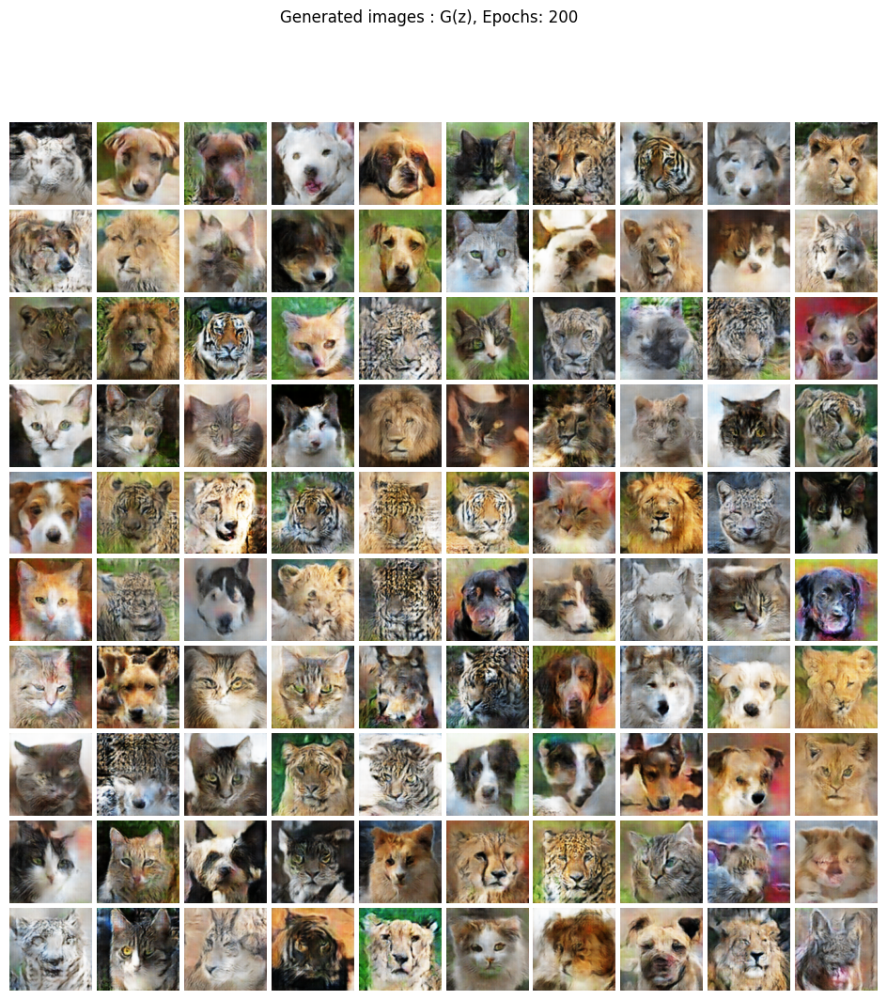

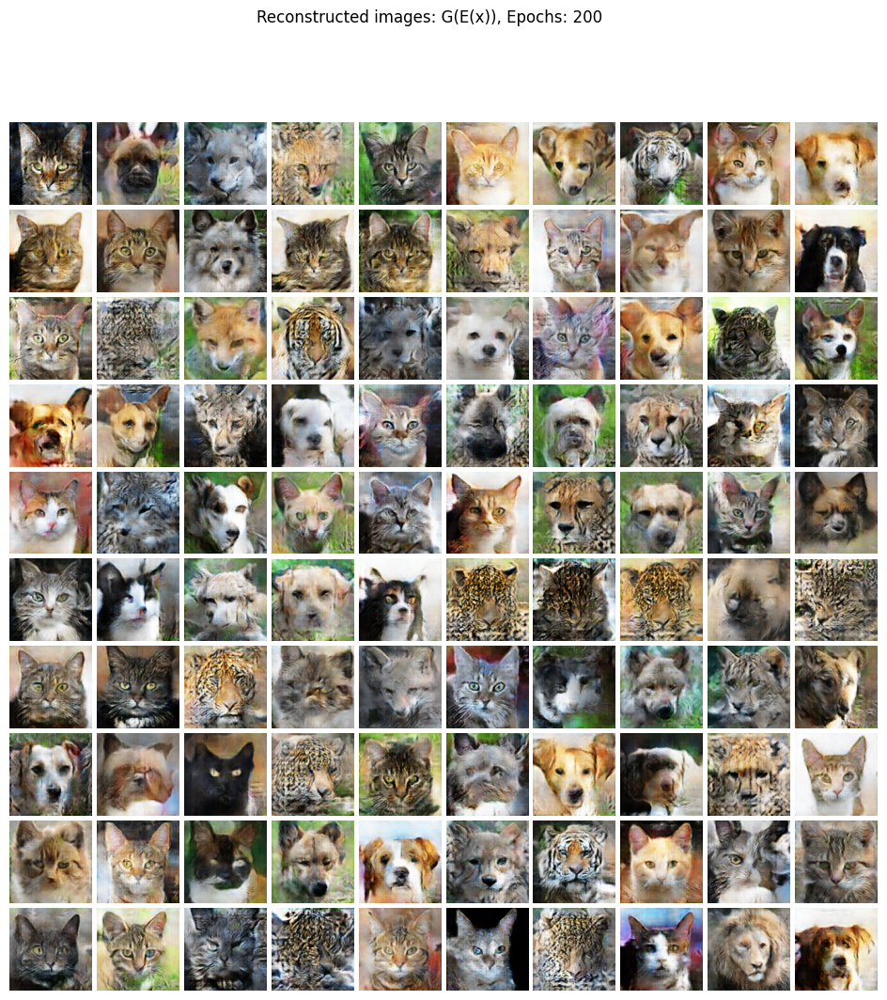

In [ ]:
train,test = load_dataset(batch_size = 100)
bigan = BiGAN(data_train=train, data_test=test,device=device, latent_dim = 100,lr = 1e-4, epochs = 200, clamp = 0.01, critic_gen_ratio=1, grad_penalty=True)
loss_GE_list, loss_D_list = bigan.train()

## Interpolated plots between pairs of latent vectors

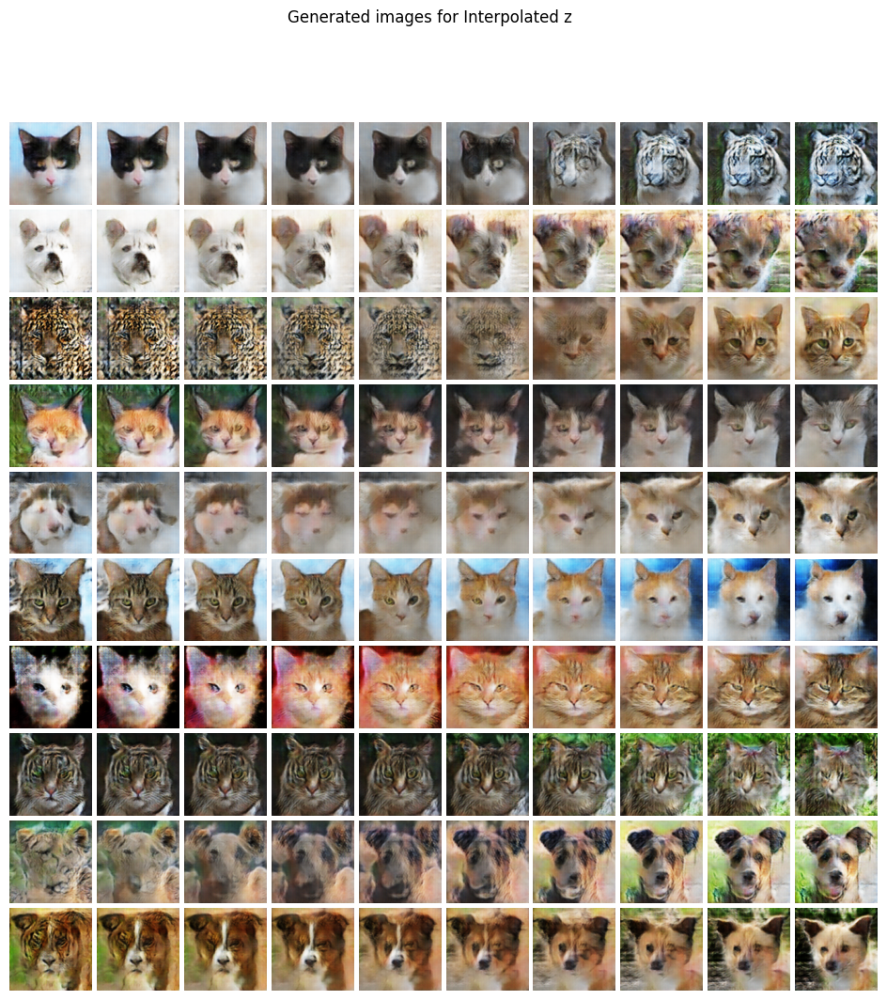

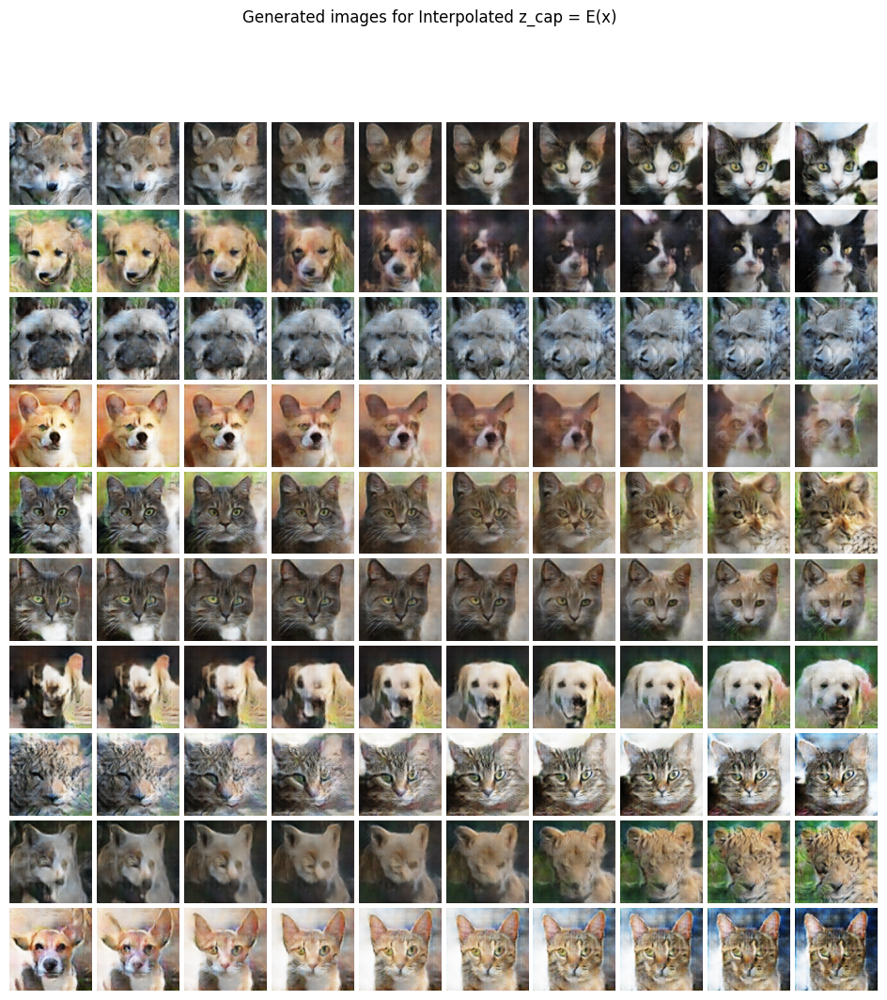

In [ ]:
bigan.interpolate_plot(title=f'Generated images for Interpolated z',num_interpolates=10,num_z=10,encoded_latent = False)
bigan.interpolate_plot(title=f'Generated images for Interpolated z_cap = E(x)',num_interpolates=10,num_z=10,encoded_latent = True)

## Loss curves across Epochs for Experiment 1

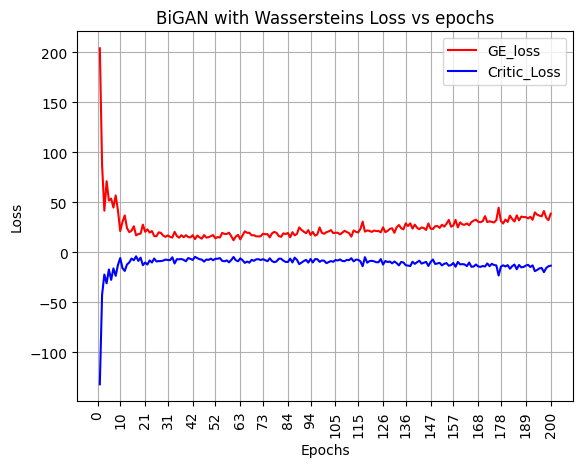

In [ ]:
bigan.plot_loss_curves(loss_GE_list, loss_D_list)

## Posterior inference and Classification

#### Options tried

- Classification through 3 types of classifiers: SVM with RBF kernel, SVM with Linear Kernel, Linear Classifier (Logistic Regression)
- PCA enabled with multiple pca_component options
- PCA disabled

### Observations

- With PCA enabled the Test accuracy is lower due to variance contribution of the Principal components being considerably less(around 0.4 as compared to the train accuracy around 0.8)
    - PCA component sweep indicates Train accuracy to increase with number of components (Values tried : 20,40,60,80). However Test accuracy didnt have significant improvement
- With PCA disabled the Test and train accuracies are comparable (Values mentioned in the next markdown)
- Linear classifier performs marginally better than the SVM
    - SVM can further be optimized based on C and Gamma hyperparameters. Only 1 value used for the experiments:
        - RBF Kernel: C=1, gamma=0.001,
        - Linear Kernel: C=0.1, gamma=NA
        Note: RBF Kernel performs better than Linear Kernel



### PCA enabled, pca_components=40, SVM with RBF Kernel

Train and Test accuracies are indicated in the following runs

100%|██████████| 147/147 [00:08<00:00, 17.92it/s]
C:\Users\user\AppData\Roaming\Python\Python310\site-packages\sklearn\svm\_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Train Accuracy: 0.8652084757347915


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


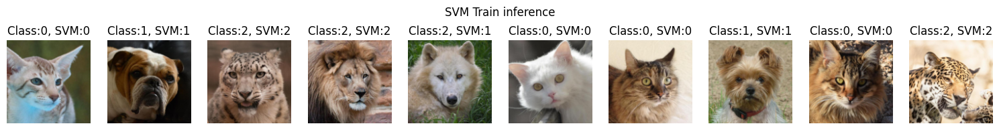

100%|██████████| 15/15 [00:01<00:00, 11.98it/s]


Test Accuracy: 0.37333333333333335


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


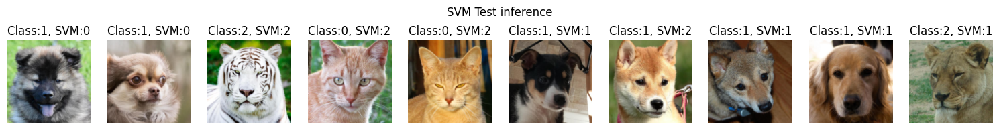

In [ ]:
bigan.post_inference(classifier='SVM',SVM_kernel='rbf',pca=True, pca_components=40)


### PCA enabled, pca_components=40, SVM with Linear Kernel

100%|██████████| 147/147 [00:08<00:00, 18.37it/s]
C:\Users\user\AppData\Roaming\Python\Python310\site-packages\sklearn\svm\_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Train Accuracy: 0.6346548188653451


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


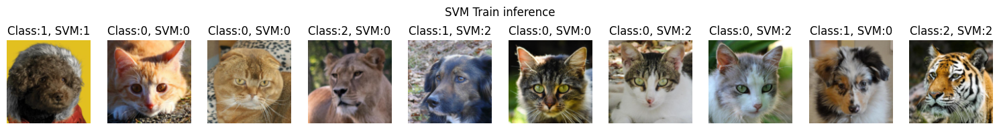

100%|██████████| 15/15 [00:01<00:00, 11.84it/s]


Test Accuracy: 0.41


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


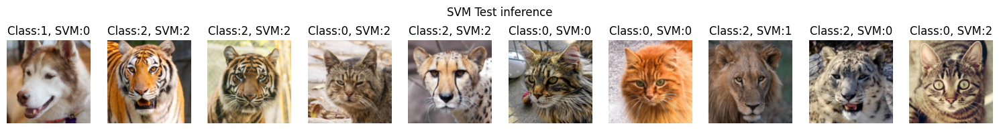

In [ ]:
bigan.post_inference(classifier='SVM',SVM_kernel='linear',pca=True, pca_components=40)


### PCA enabled, pca_components=40, Linear Classifier

100%|██████████| 147/147 [00:08<00:00, 18.18it/s]


Train Accuracy: 0.8736842105263158


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


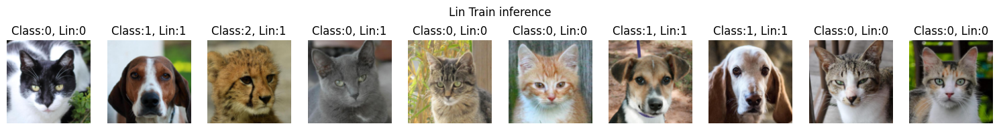

100%|██████████| 15/15 [00:01<00:00, 13.01it/s]


Test Accuracy: 0.36933333333333335


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


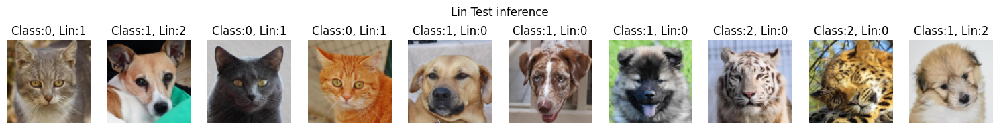

In [ ]:
bigan.post_inference(classifier='Lin',SVM_kernel='linear',pca=True, pca_components=40)

### PCA enabled, pca_components={20,60,80}, SVM with RBF Kernel

In all the below experiments, the test accuracy is not comparable to the train accuracy indicating overfitting of the classifier.

100%|██████████| 147/147 [00:08<00:00, 18.07it/s]
C:\Users\user\AppData\Roaming\Python\Python310\site-packages\sklearn\svm\_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Train Accuracy: 0.7652768284347232


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


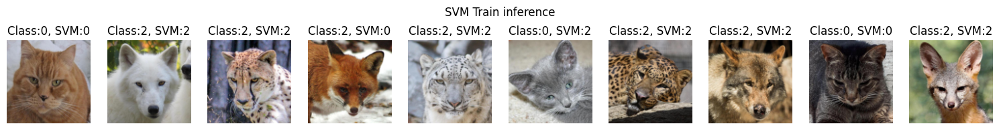

100%|██████████| 15/15 [00:01<00:00, 12.00it/s]


Test Accuracy: 0.3566666666666667


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


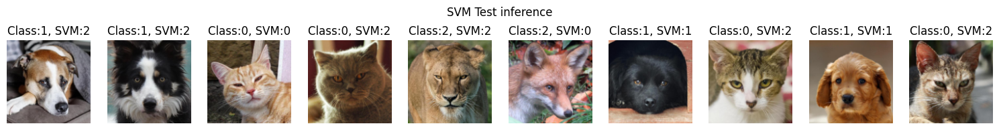

100%|██████████| 147/147 [00:08<00:00, 18.22it/s]
C:\Users\user\AppData\Roaming\Python\Python310\site-packages\sklearn\svm\_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Train Accuracy: 0.8735475051264525


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


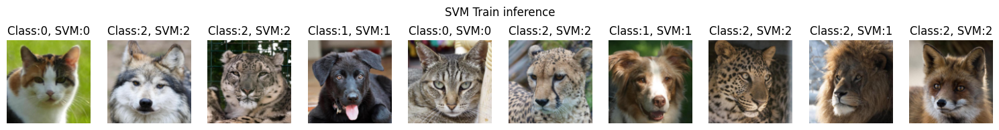

100%|██████████| 15/15 [00:01<00:00, 12.95it/s]


Test Accuracy: 0.38666666666666666


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


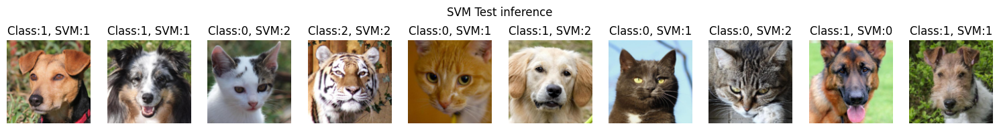

100%|██████████| 147/147 [00:08<00:00, 18.22it/s]
C:\Users\user\AppData\Roaming\Python\Python310\site-packages\sklearn\svm\_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Train Accuracy: 0.8933014354066986


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


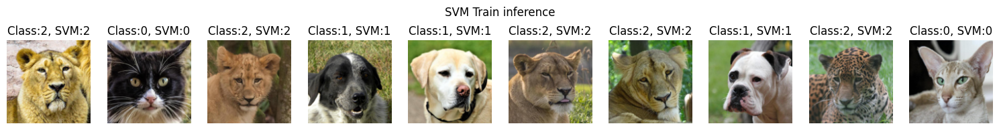

100%|██████████| 15/15 [00:01<00:00, 13.08it/s]


Test Accuracy: 0.37333333333333335


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


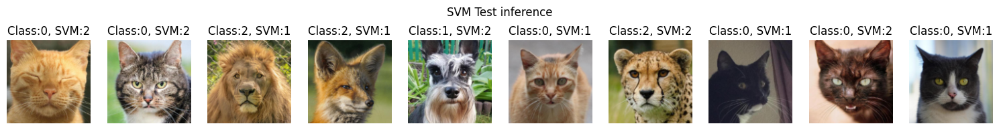

In [ ]:
bigan.post_inference(classifier='SVM',SVM_kernel='rbf',pca=True, pca_components=20)
bigan.post_inference(classifier='SVM',SVM_kernel='rbf',pca=True, pca_components=60)
bigan.post_inference(classifier='SVM',SVM_kernel='rbf',pca=True, pca_components=80)

### PCA disabled, pca_components=80, SVM with RBF Kernel

100%|██████████| 147/147 [00:07<00:00, 18.72it/s]
C:\Users\user\AppData\Roaming\Python\Python310\site-packages\sklearn\svm\_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Train Accuracy: 0.897881066302119


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


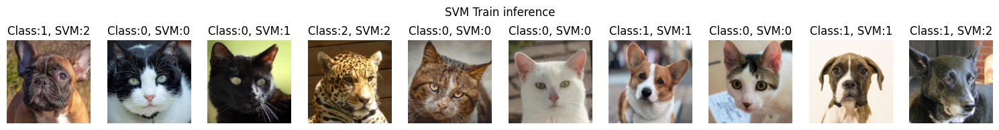

100%|██████████| 15/15 [00:01<00:00, 11.97it/s]


Test Accuracy: 0.886


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


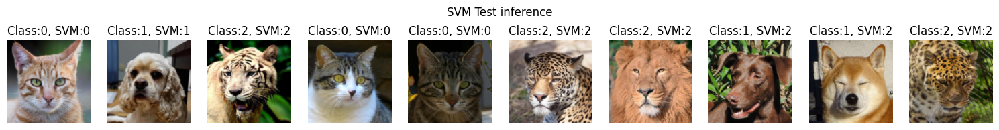

In [ ]:
bigan.post_inference(classifier='SVM',SVM_kernel='rbf',pca=False, pca_components=80)

### PCA disabled, pca_components=80, SVM with Linear Kernel

100%|██████████| 147/147 [00:08<00:00, 18.26it/s]
C:\Users\user\AppData\Roaming\Python\Python310\site-packages\sklearn\svm\_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Train Accuracy: 0.7890635680109365


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


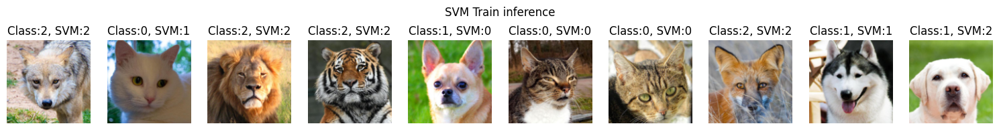

100%|██████████| 15/15 [00:01<00:00, 11.55it/s]
C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


Test Accuracy: 0.7713333333333333


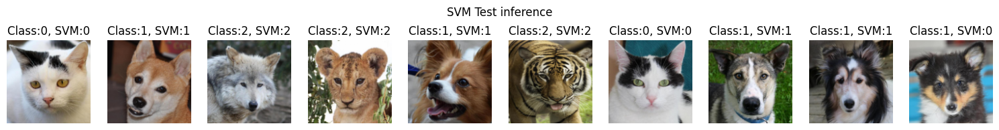

In [ ]:
bigan.post_inference(classifier='SVM',SVM_kernel='linear',pca=False, pca_components=80)

### PCA disabled, pca_components=80, Linear Classifier

100%|██████████| 147/147 [00:07<00:00, 18.38it/s]


Train Accuracy: 0.9062884483937116


C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


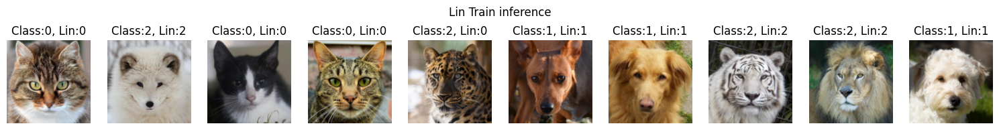

100%|██████████| 15/15 [00:01<00:00, 12.32it/s]
C:\Users\user\AppData\Local\Temp\ipykernel_13832\2980525435.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


Test Accuracy: 0.9046666666666666


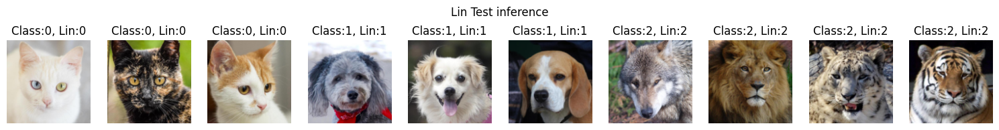

In [ ]:
bigan.post_inference(classifier='Lin',SVM_kernel='linear',pca=False, pca_components=80)

# Experiment 2  -  Training with Weight Clipping

## Note: that the error at the end of the output was because of a missing function definition. The plots that were meant to be generated at the end of training are plotted in the subsequent cells.

- Weight Clipping approach used
- Parameters:
    - Epochs : 200
    - Learning rate: 1e-4
    - Latent dimensions: 100
    - Critic to Gen-Encoder training ratio : 1
    - The clamping/clipping value: 0.01

### Observations:

- Gradient penalty method performs better than the Weight clipping method (Both Generated and Reconstructed images in clipping method is not proper)
- The losses dont seem to converge
- Need more experiments on the clipping value and learning rate to find cases where clipping will be effective
- The Classifier accuracies are also low as expected

In [ ]:
train,test = load_dataset(batch_size = 100)
bigan = BiGAN(data_train=train, data_test=test,device=device, latent_dim = 100,lr = 1e-4, epochs = 200, clamp = 0.01, critic_gen_ratio=1, grad_penalty=False)
loss_GE_list, loss_D_list = bigan.train()

100%|██████████| 147/147 [00:30<00:00,  4.80it/s]


Epoch [1/200], Avg_Loss_D: -1102.8005, Avg_Loss_EG: 2946.1911


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [2/200], Avg_Loss_D: 15873.7207, Avg_Loss_EG: 4621.7595


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [3/200], Avg_Loss_D: -3681.8737, Avg_Loss_EG: 23982.1040


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [4/200], Avg_Loss_D: 332.2895, Avg_Loss_EG: 1534.7407


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [5/200], Avg_Loss_D: 18215.1175, Avg_Loss_EG: 865.1990


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [6/200], Avg_Loss_D: 977.0054, Avg_Loss_EG: 4321.6463


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [7/200], Avg_Loss_D: -22064.5727, Avg_Loss_EG: 75489.8688


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [8/200], Avg_Loss_D: -19243.2440, Avg_Loss_EG: 127065.5291


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [9/200], Avg_Loss_D: 129640.8014, Avg_Loss_EG: 68403.7622


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [10/200], Avg_Loss_D: 76204.3750, Avg_Loss_EG: 61904.5747


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [11/200], Avg_Loss_D: 11898.4428, Avg_Loss_EG: 49536.8277


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [12/200], Avg_Loss_D: 14146.7810, Avg_Loss_EG: 49892.7951


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [13/200], Avg_Loss_D: -7281.2431, Avg_Loss_EG: 72015.5149


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [14/200], Avg_Loss_D: 54698.8159, Avg_Loss_EG: 111481.6383


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [15/200], Avg_Loss_D: 1870.1627, Avg_Loss_EG: 118619.4901


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [16/200], Avg_Loss_D: 12439.9797, Avg_Loss_EG: 182192.4279


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [17/200], Avg_Loss_D: 78306.2755, Avg_Loss_EG: 32251.3319


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [18/200], Avg_Loss_D: 32064.2328, Avg_Loss_EG: 122038.4611


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [19/200], Avg_Loss_D: 109629.5274, Avg_Loss_EG: 404401.9340


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [20/200], Avg_Loss_D: 168237.7862, Avg_Loss_EG: 466793.2773


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [21/200], Avg_Loss_D: -481403.8882, Avg_Loss_EG: 1642140.7488


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [22/200], Avg_Loss_D: 137852.6409, Avg_Loss_EG: 757391.3700


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [23/200], Avg_Loss_D: 151362.0875, Avg_Loss_EG: 838197.4386


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [24/200], Avg_Loss_D: -334215.8202, Avg_Loss_EG: 2640183.8937


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [25/200], Avg_Loss_D: -643546.5731, Avg_Loss_EG: 5597402.5612


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [26/200], Avg_Loss_D: 988320.8390, Avg_Loss_EG: -30876.4845


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [27/200], Avg_Loss_D: 169761.3902, Avg_Loss_EG: 184458.1555


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [28/200], Avg_Loss_D: -22043.6922, Avg_Loss_EG: 820129.9206


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [29/200], Avg_Loss_D: 73431.7042, Avg_Loss_EG: 1063090.7851


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [30/200], Avg_Loss_D: -494741.9923, Avg_Loss_EG: 1392232.6978


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [31/200], Avg_Loss_D: 481126.7777, Avg_Loss_EG: 128295.3442


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [32/200], Avg_Loss_D: -100801.1439, Avg_Loss_EG: 681710.2327


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [33/200], Avg_Loss_D: -114877.6779, Avg_Loss_EG: 748836.2102


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [34/200], Avg_Loss_D: 156947.8991, Avg_Loss_EG: 617819.5147


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [35/200], Avg_Loss_D: -19184.5408, Avg_Loss_EG: 1372222.3584


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [36/200], Avg_Loss_D: 572164.0685, Avg_Loss_EG: 206153.0603


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [37/200], Avg_Loss_D: -263825.4719, Avg_Loss_EG: 812006.2047


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [38/200], Avg_Loss_D: 51165.0341, Avg_Loss_EG: 285615.3814


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [39/200], Avg_Loss_D: 57338.7894, Avg_Loss_EG: 38648.9881


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [40/200], Avg_Loss_D: -43584.3668, Avg_Loss_EG: 488933.4979


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [41/200], Avg_Loss_D: 345583.5625, Avg_Loss_EG: 29063.6330


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [42/200], Avg_Loss_D: -239017.7038, Avg_Loss_EG: 953346.8782


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [43/200], Avg_Loss_D: 271374.4064, Avg_Loss_EG: 176594.8077


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [44/200], Avg_Loss_D: 127308.5931, Avg_Loss_EG: 476994.2301


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [45/200], Avg_Loss_D: -417973.7517, Avg_Loss_EG: 1610502.7338


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [46/200], Avg_Loss_D: 140085.3155, Avg_Loss_EG: 1428470.1031


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [47/200], Avg_Loss_D: 234406.6519, Avg_Loss_EG: 676663.4004


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [48/200], Avg_Loss_D: -220999.0885, Avg_Loss_EG: 981893.9600


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [49/200], Avg_Loss_D: 237038.5759, Avg_Loss_EG: 251811.7921


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [50/200], Avg_Loss_D: -577026.4014, Avg_Loss_EG: 1768340.6226


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [51/200], Avg_Loss_D: 17709.8893, Avg_Loss_EG: 588948.2868


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [52/200], Avg_Loss_D: 213711.4009, Avg_Loss_EG: 610728.1327


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [53/200], Avg_Loss_D: 349387.8528, Avg_Loss_EG: 844122.9420


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [54/200], Avg_Loss_D: 541787.7207, Avg_Loss_EG: 1325932.7679


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [55/200], Avg_Loss_D: 428236.0899, Avg_Loss_EG: 512402.1488


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [56/200], Avg_Loss_D: -68684.9930, Avg_Loss_EG: 1000663.9680


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [57/200], Avg_Loss_D: 258356.8951, Avg_Loss_EG: 312575.6412


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [58/200], Avg_Loss_D: 27738.0624, Avg_Loss_EG: 420070.5664


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [59/200], Avg_Loss_D: 292971.7894, Avg_Loss_EG: 545354.0162


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [60/200], Avg_Loss_D: 474061.1145, Avg_Loss_EG: 124706.7680


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [61/200], Avg_Loss_D: 64953.3515, Avg_Loss_EG: 489858.6694


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [62/200], Avg_Loss_D: 86796.1649, Avg_Loss_EG: 759101.4621


100%|██████████| 147/147 [00:28<00:00,  5.22it/s]


Epoch [63/200], Avg_Loss_D: -496929.9223, Avg_Loss_EG: 1175028.7317


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [64/200], Avg_Loss_D: -1224459.2598, Avg_Loss_EG: 2927301.6804


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [65/200], Avg_Loss_D: -161473.7545, Avg_Loss_EG: 3213177.3248


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [66/200], Avg_Loss_D: 27977.0648, Avg_Loss_EG: 1623693.8733


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [67/200], Avg_Loss_D: 41066.0056, Avg_Loss_EG: 238159.1305


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [68/200], Avg_Loss_D: 49293.2518, Avg_Loss_EG: 908022.6174


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [69/200], Avg_Loss_D: 130572.0616, Avg_Loss_EG: 717340.1828


100%|██████████| 147/147 [00:28<00:00,  5.22it/s]


Epoch [70/200], Avg_Loss_D: -230311.3167, Avg_Loss_EG: 1579820.0879


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [71/200], Avg_Loss_D: 31869.4634, Avg_Loss_EG: 481471.4240


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [72/200], Avg_Loss_D: -17229.3470, Avg_Loss_EG: 392414.2868


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [73/200], Avg_Loss_D: 236408.1794, Avg_Loss_EG: 550010.0393


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [74/200], Avg_Loss_D: -21692.7619, Avg_Loss_EG: 700371.5186


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [75/200], Avg_Loss_D: 55937.0030, Avg_Loss_EG: 235862.0074


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [76/200], Avg_Loss_D: 16526.3107, Avg_Loss_EG: 388357.7147


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [77/200], Avg_Loss_D: 297305.6746, Avg_Loss_EG: 469638.1336


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [78/200], Avg_Loss_D: -522519.4980, Avg_Loss_EG: 1353966.9899


100%|██████████| 147/147 [00:28<00:00,  5.22it/s]


Epoch [79/200], Avg_Loss_D: -32688.7342, Avg_Loss_EG: 1213958.2197


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [80/200], Avg_Loss_D: -6344.6475, Avg_Loss_EG: 57173.9086


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [81/200], Avg_Loss_D: 1575.5163, Avg_Loss_EG: 165855.3929


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [82/200], Avg_Loss_D: -4190.3830, Avg_Loss_EG: 275047.0914


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [83/200], Avg_Loss_D: 427528.2667, Avg_Loss_EG: 272850.0819


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [84/200], Avg_Loss_D: 74518.4785, Avg_Loss_EG: 607934.2690


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [85/200], Avg_Loss_D: 493071.6754, Avg_Loss_EG: 293647.6063


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [86/200], Avg_Loss_D: 56071.2994, Avg_Loss_EG: 909277.9005


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [87/200], Avg_Loss_D: -491555.9086, Avg_Loss_EG: 2567741.6650


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [88/200], Avg_Loss_D: 1198403.5520, Avg_Loss_EG: -144396.8509


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [89/200], Avg_Loss_D: 575499.3676, Avg_Loss_EG: 451841.6929


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [90/200], Avg_Loss_D: 447053.8892, Avg_Loss_EG: 125734.1110


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [91/200], Avg_Loss_D: 63006.5437, Avg_Loss_EG: 519353.8856


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [92/200], Avg_Loss_D: -28418.8850, Avg_Loss_EG: 509246.3602


100%|██████████| 147/147 [00:28<00:00,  5.23it/s]


Epoch [93/200], Avg_Loss_D: 13666.1664, Avg_Loss_EG: 141012.4484


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [94/200], Avg_Loss_D: 238343.4155, Avg_Loss_EG: 220119.0359


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [95/200], Avg_Loss_D: 582119.1677, Avg_Loss_EG: 587021.8368


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [96/200], Avg_Loss_D: 700197.7951, Avg_Loss_EG: 141100.3954


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [97/200], Avg_Loss_D: 303567.9179, Avg_Loss_EG: 763177.5723


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [98/200], Avg_Loss_D: -423547.6314, Avg_Loss_EG: 2822985.9977


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [99/200], Avg_Loss_D: 1231254.5084, Avg_Loss_EG: 1512633.3206


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [100/200], Avg_Loss_D: 1129450.3873, Avg_Loss_EG: 1413523.5459


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [101/200], Avg_Loss_D: -136344.0400, Avg_Loss_EG: 2610637.7421


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [102/200], Avg_Loss_D: 1804052.2432, Avg_Loss_EG: 2176008.8639


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [103/200], Avg_Loss_D: 1466218.5446, Avg_Loss_EG: 1535130.2292


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [104/200], Avg_Loss_D: 691859.6165, Avg_Loss_EG: 2691567.2075


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [105/200], Avg_Loss_D: 2136288.3036, Avg_Loss_EG: 2071224.8546


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [106/200], Avg_Loss_D: 3455644.2156, Avg_Loss_EG: 1545695.5383


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [107/200], Avg_Loss_D: 3333059.1595, Avg_Loss_EG: 2272458.2406


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [108/200], Avg_Loss_D: 2518136.0842, Avg_Loss_EG: 2907604.8661


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [109/200], Avg_Loss_D: 3687523.0043, Avg_Loss_EG: 3935648.2738


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [110/200], Avg_Loss_D: 2843905.5799, Avg_Loss_EG: 4327850.7296


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [111/200], Avg_Loss_D: 4866081.5638, Avg_Loss_EG: 1924793.7406


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [112/200], Avg_Loss_D: 2823382.8588, Avg_Loss_EG: 3084396.2015


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [113/200], Avg_Loss_D: 3305479.3478, Avg_Loss_EG: 2904912.1310


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [114/200], Avg_Loss_D: 2880754.4617, Avg_Loss_EG: 2847358.1131


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [115/200], Avg_Loss_D: 2133021.4392, Avg_Loss_EG: 4126549.5200


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [116/200], Avg_Loss_D: 1888208.7925, Avg_Loss_EG: 3731841.6679


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [117/200], Avg_Loss_D: 4714908.5306, Avg_Loss_EG: 1650302.0544


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [118/200], Avg_Loss_D: 3930547.6144, Avg_Loss_EG: 3444701.1607


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [119/200], Avg_Loss_D: 1336923.4303, Avg_Loss_EG: 5885781.9715


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [120/200], Avg_Loss_D: 1895018.2738, Avg_Loss_EG: 5276738.5098


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [121/200], Avg_Loss_D: 4026515.6052, Avg_Loss_EG: 2725027.4067


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [122/200], Avg_Loss_D: 1125803.4026, Avg_Loss_EG: 5351072.1718


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [123/200], Avg_Loss_D: 1990083.6739, Avg_Loss_EG: 5145686.7151


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [124/200], Avg_Loss_D: 2762337.0946, Avg_Loss_EG: 2670124.2555


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [125/200], Avg_Loss_D: 3145841.7402, Avg_Loss_EG: 2832725.9337


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [126/200], Avg_Loss_D: 2228144.1739, Avg_Loss_EG: 2691717.4847


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [127/200], Avg_Loss_D: -37113.0510, Avg_Loss_EG: 5124680.5525


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [128/200], Avg_Loss_D: 4829176.2683, Avg_Loss_EG: 961483.4792


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [129/200], Avg_Loss_D: 2412880.9045, Avg_Loss_EG: 3495313.7474


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [130/200], Avg_Loss_D: 1601437.6505, Avg_Loss_EG: 4207533.3108


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [131/200], Avg_Loss_D: 1697636.8946, Avg_Loss_EG: 4787076.8997


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [132/200], Avg_Loss_D: 4742231.6709, Avg_Loss_EG: 1659502.8350


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [133/200], Avg_Loss_D: 3194869.8129, Avg_Loss_EG: 3026482.5055


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [134/200], Avg_Loss_D: 1798936.5179, Avg_Loss_EG: 4699563.2917


100%|██████████| 147/147 [00:28<00:00,  5.14it/s]


Epoch [135/200], Avg_Loss_D: 2063276.2730, Avg_Loss_EG: 5621172.7245


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [136/200], Avg_Loss_D: 4748056.4911, Avg_Loss_EG: 2211614.7484


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [137/200], Avg_Loss_D: 4310496.0261, Avg_Loss_EG: 2766275.8520


100%|██████████| 147/147 [00:28<00:00,  5.10it/s]


Epoch [138/200], Avg_Loss_D: 4000131.0723, Avg_Loss_EG: 3764663.6896


100%|██████████| 147/147 [00:28<00:00,  5.13it/s]


Epoch [139/200], Avg_Loss_D: 811012.3673, Avg_Loss_EG: 7023341.8971


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [140/200], Avg_Loss_D: 3270362.2539, Avg_Loss_EG: 6124461.6392


100%|██████████| 147/147 [00:28<00:00,  5.22it/s]


Epoch [141/200], Avg_Loss_D: 5817852.2891, Avg_Loss_EG: 4507464.3248


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [142/200], Avg_Loss_D: 6096191.1901, Avg_Loss_EG: 2960727.2530


100%|██████████| 147/147 [00:28<00:00,  5.12it/s]


Epoch [143/200], Avg_Loss_D: 4310251.8873, Avg_Loss_EG: 4881943.6930


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [144/200], Avg_Loss_D: 2278589.8006, Avg_Loss_EG: 7813966.4065


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [145/200], Avg_Loss_D: 5925965.7611, Avg_Loss_EG: 3184719.0383


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [146/200], Avg_Loss_D: 6195711.1964, Avg_Loss_EG: 3282722.1947


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [147/200], Avg_Loss_D: 3012390.8359, Avg_Loss_EG: 5238883.7466


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [148/200], Avg_Loss_D: 2172295.4362, Avg_Loss_EG: 7370498.8890


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [149/200], Avg_Loss_D: 2313541.9568, Avg_Loss_EG: 6603113.7708


100%|██████████| 147/147 [00:28<00:00,  5.22it/s]


Epoch [150/200], Avg_Loss_D: 7415235.0203, Avg_Loss_EG: 1452603.7595


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [151/200], Avg_Loss_D: 4046352.9184, Avg_Loss_EG: 4254653.3185


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [152/200], Avg_Loss_D: 2566979.6798, Avg_Loss_EG: 6796408.1641


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [153/200], Avg_Loss_D: 1970224.1127, Avg_Loss_EG: 6022757.1497


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [154/200], Avg_Loss_D: 6508517.5578, Avg_Loss_EG: 3363056.8457


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [155/200], Avg_Loss_D: 5566078.2466, Avg_Loss_EG: 1951900.2547


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [156/200], Avg_Loss_D: 1653014.4141, Avg_Loss_EG: 5352723.5548


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [157/200], Avg_Loss_D: 4761508.2670, Avg_Loss_EG: 2792505.7942


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [158/200], Avg_Loss_D: 3401660.6658, Avg_Loss_EG: 2725533.9787


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [159/200], Avg_Loss_D: 551507.8244, Avg_Loss_EG: 5673136.9281


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [160/200], Avg_Loss_D: 4799556.2398, Avg_Loss_EG: 1425998.8644


100%|██████████| 147/147 [00:28<00:00,  5.13it/s]


Epoch [161/200], Avg_Loss_D: 2992210.3673, Avg_Loss_EG: 3551234.1607


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [162/200], Avg_Loss_D: 668424.2520, Avg_Loss_EG: 6147772.6060


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [163/200], Avg_Loss_D: 5296563.8142, Avg_Loss_EG: 2139999.1118


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [164/200], Avg_Loss_D: 2061183.5969, Avg_Loss_EG: 3628635.4522


100%|██████████| 147/147 [00:28<00:00,  5.22it/s]


Epoch [165/200], Avg_Loss_D: 2406744.6577, Avg_Loss_EG: 3170352.4681


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [166/200], Avg_Loss_D: 2768486.7432, Avg_Loss_EG: 2580196.1433


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [167/200], Avg_Loss_D: 544673.1344, Avg_Loss_EG: 5954544.1888


100%|██████████| 147/147 [00:28<00:00,  5.21it/s]


Epoch [168/200], Avg_Loss_D: 3257329.3614, Avg_Loss_EG: 3854044.3946


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [169/200], Avg_Loss_D: 3722213.2500, Avg_Loss_EG: 2446322.3202


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [170/200], Avg_Loss_D: -141630.7330, Avg_Loss_EG: 6166774.2725


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [171/200], Avg_Loss_D: 4224587.8002, Avg_Loss_EG: 3992754.3418


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [172/200], Avg_Loss_D: 3968315.8639, Avg_Loss_EG: 4612168.0000


100%|██████████| 147/147 [00:28<00:00,  5.09it/s]


Epoch [173/200], Avg_Loss_D: 37767.0162, Avg_Loss_EG: 8358187.7611


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [174/200], Avg_Loss_D: 7014364.4779, Avg_Loss_EG: 2965793.5799


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [175/200], Avg_Loss_D: 4365656.1369, Avg_Loss_EG: 4461779.1003


100%|██████████| 147/147 [00:28<00:00,  5.18it/s]


Epoch [176/200], Avg_Loss_D: 121520.5816, Avg_Loss_EG: 8732152.3724


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [177/200], Avg_Loss_D: 7833564.9184, Avg_Loss_EG: 1169809.3112


100%|██████████| 147/147 [00:28<00:00,  5.20it/s]


Epoch [178/200], Avg_Loss_D: 3761215.0485, Avg_Loss_EG: 5420643.3810


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [179/200], Avg_Loss_D: -572404.8312, Avg_Loss_EG: 9234094.9600


100%|██████████| 147/147 [00:28<00:00,  5.19it/s]


Epoch [180/200], Avg_Loss_D: 5462053.9753, Avg_Loss_EG: 4863625.6786


100%|██████████| 147/147 [00:28<00:00,  5.09it/s]


Epoch [181/200], Avg_Loss_D: 6607865.3129, Avg_Loss_EG: 5543317.2015


100%|██████████| 147/147 [00:28<00:00,  5.11it/s]


Epoch [182/200], Avg_Loss_D: 4467826.5884, Avg_Loss_EG: 8593752.1981


100%|██████████| 147/147 [00:28<00:00,  5.14it/s]


Epoch [183/200], Avg_Loss_D: 5382369.4694, Avg_Loss_EG: 9901234.8299


100%|██████████| 147/147 [00:28<00:00,  5.14it/s]


Epoch [184/200], Avg_Loss_D: 511428.5425, Avg_Loss_EG: 11755610.5527


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [185/200], Avg_Loss_D: 9166592.5595, Avg_Loss_EG: 4189880.0757


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [186/200], Avg_Loss_D: 6146415.3797, Avg_Loss_EG: 8490762.8053


100%|██████████| 147/147 [00:28<00:00,  5.14it/s]


Epoch [187/200], Avg_Loss_D: 14077.2764, Avg_Loss_EG: 14544813.4804


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [188/200], Avg_Loss_D: 4674457.6429, Avg_Loss_EG: 14611004.5510


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [189/200], Avg_Loss_D: 5851923.4031, Avg_Loss_EG: 12643215.6922


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [190/200], Avg_Loss_D: 10026430.1565, Avg_Loss_EG: 9469854.8240


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [191/200], Avg_Loss_D: 9401866.7109, Avg_Loss_EG: 11681919.1267


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [192/200], Avg_Loss_D: 8707084.1327, Avg_Loss_EG: 12122892.1599


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [193/200], Avg_Loss_D: 4502450.5561, Avg_Loss_EG: 17902357.0264


100%|██████████| 147/147 [00:28<00:00,  5.13it/s]


Epoch [194/200], Avg_Loss_D: 5955680.5334, Avg_Loss_EG: 14862724.3841


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [195/200], Avg_Loss_D: 12573335.1939, Avg_Loss_EG: 8629791.5808


100%|██████████| 147/147 [00:28<00:00,  5.14it/s]


Epoch [196/200], Avg_Loss_D: 6618788.9630, Avg_Loss_EG: 13951643.6037


100%|██████████| 147/147 [00:28<00:00,  5.15it/s]


Epoch [197/200], Avg_Loss_D: 4747381.2236, Avg_Loss_EG: 13904083.2232


100%|██████████| 147/147 [00:28<00:00,  5.17it/s]


Epoch [198/200], Avg_Loss_D: 12668036.3673, Avg_Loss_EG: 5148676.9694


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [199/200], Avg_Loss_D: 7222250.8801, Avg_Loss_EG: 15124824.4592


100%|██████████| 147/147 [00:28<00:00,  5.16it/s]


Epoch [200/200], Avg_Loss_D: 8405598.4932, Avg_Loss_EG: 13890784.3537


NameError: name 'normalize' is not defined

# Generated and Reconstructed images after running 200 epochs.

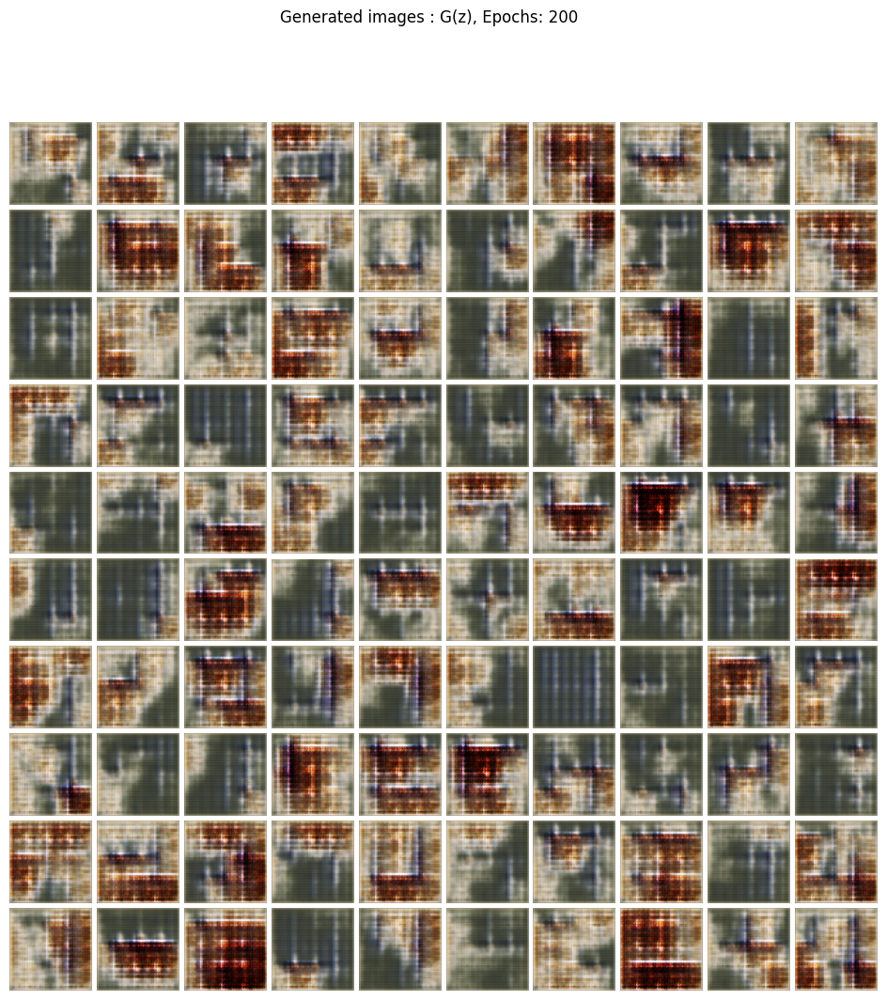

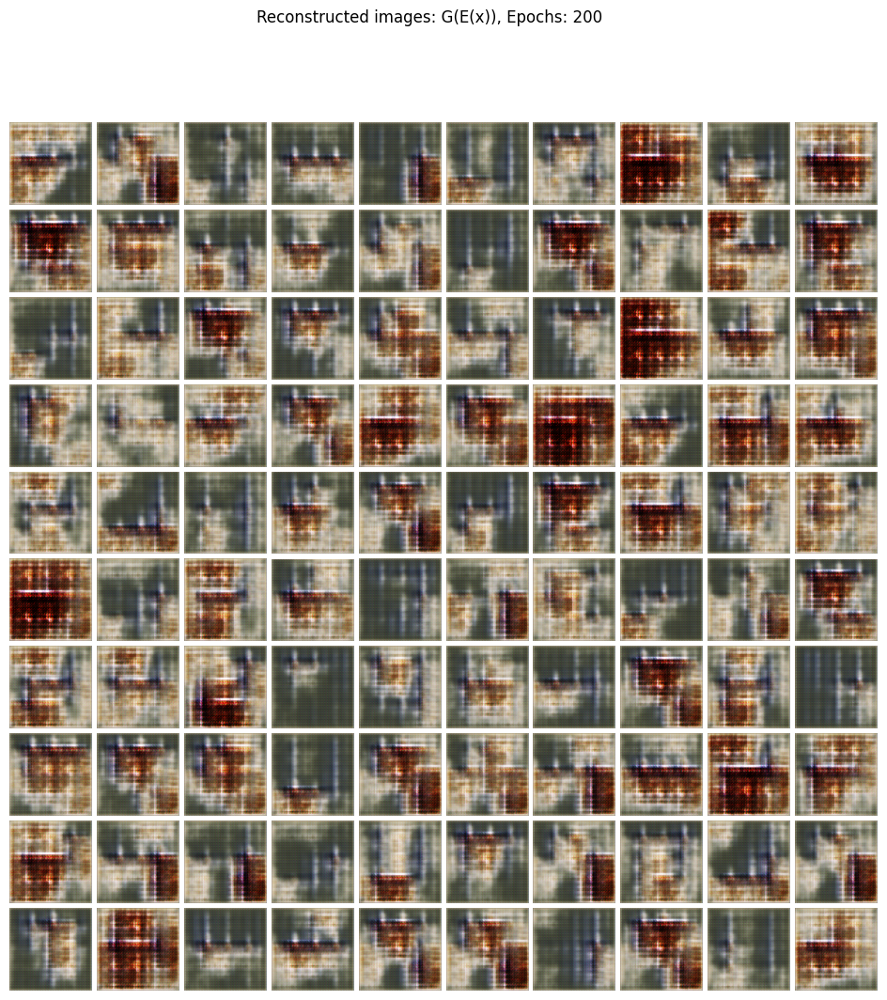

In [ ]:
bigan.plots(title=f'Generated images : G(z), Epochs: 200',encoded_latent = False)
bigan.plots(title=f'Reconstructed images: G(E(x)), Epochs: 200',encoded_latent = True)

## Interpolated plots between pairs of latent vectors

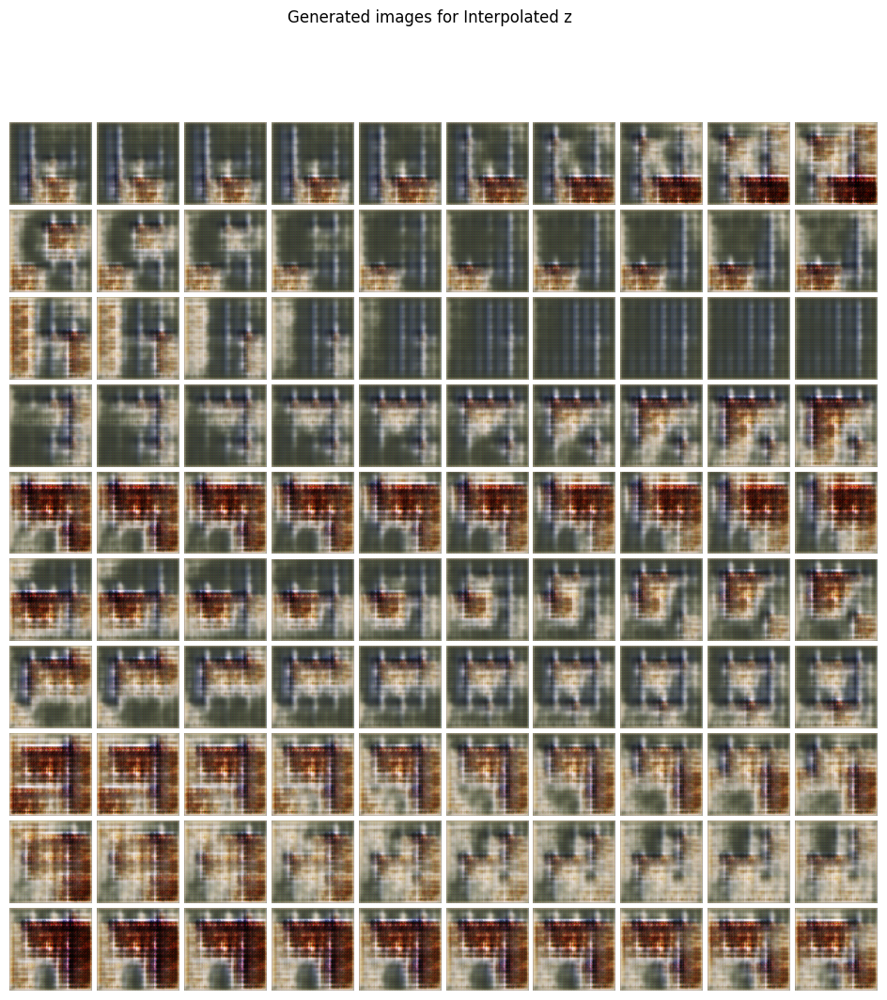

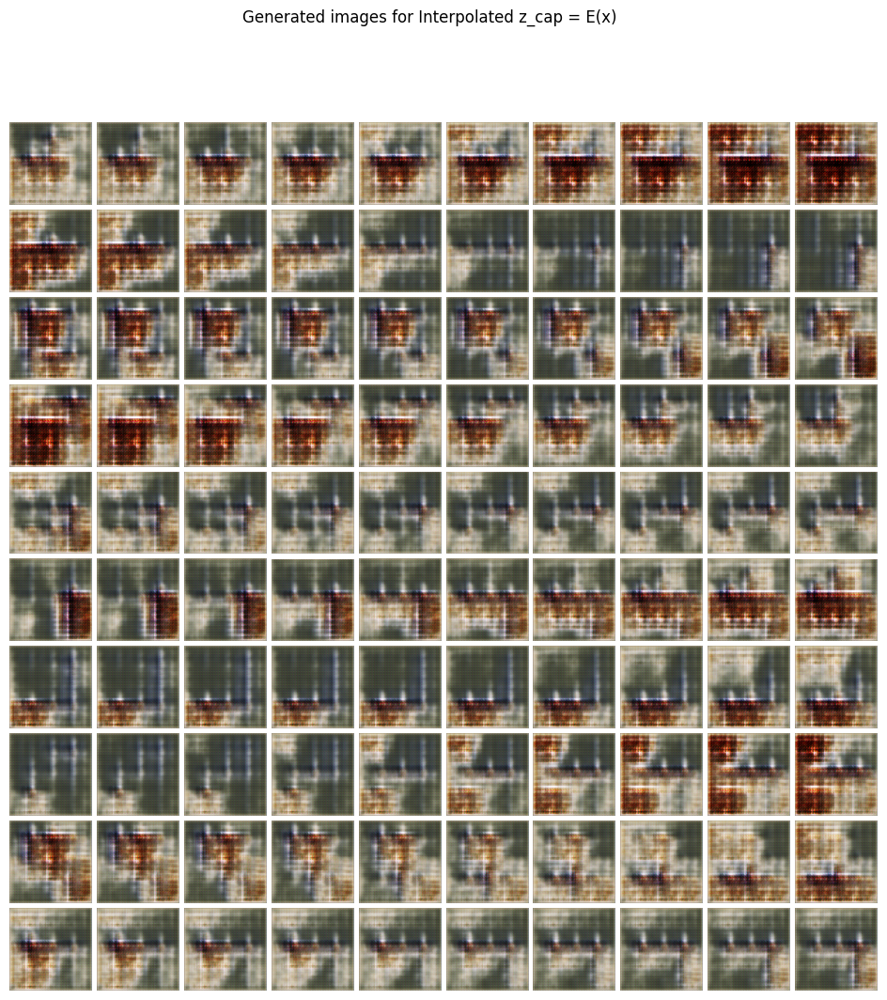

In [ ]:
bigan.interpolate_plot(title=f'Generated images for Interpolated z',num_interpolates=10,num_z=10,encoded_latent = False)
bigan.interpolate_plot(title=f'Generated images for Interpolated z_cap = E(x)',num_interpolates=10,num_z=10,encoded_latent = True)

100%|██████████| 147/147 [00:08<00:00, 17.96it/s]
C:\Users\user\AppData\Roaming\Python\Python310\site-packages\sklearn\svm\_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Train Accuracy: 0.47648667122351335


C:\Users\user\AppData\Local\Temp\ipykernel_13328\3212717235.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


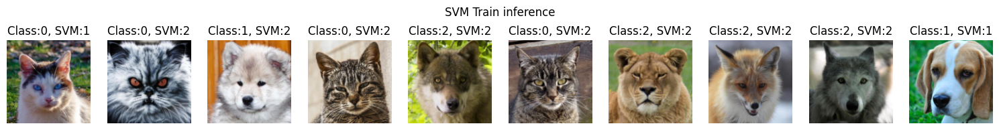

100%|██████████| 15/15 [00:01<00:00, 12.10it/s]


Test Accuracy: 0.4646666666666667


C:\Users\user\AppData\Local\Temp\ipykernel_13328\3212717235.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


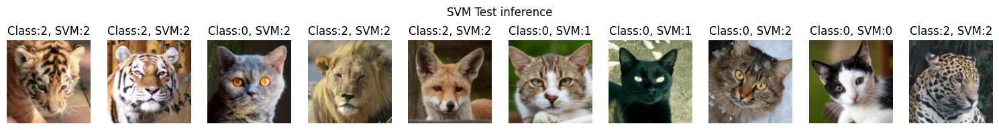

In [ ]:
bigan.post_inference(classifier='SVM',SVM_kernel='rbf',pca=False, pca_components=80)

100%|██████████| 147/147 [00:08<00:00, 18.22it/s]
C:\Users\user\AppData\Roaming\Python\Python310\site-packages\sklearn\svm\_base.py:299: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(


Train Accuracy: 0.45659603554340394


C:\Users\user\AppData\Local\Temp\ipykernel_13328\3212717235.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


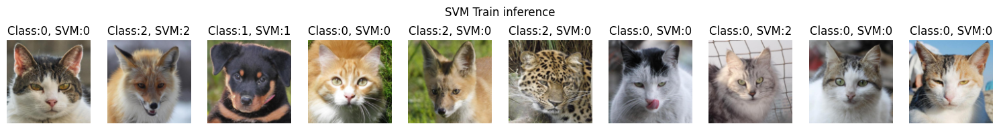

100%|██████████| 15/15 [00:01<00:00, 12.30it/s]


Test Accuracy: 0.44266666666666665


C:\Users\user\AppData\Local\Temp\ipykernel_13328\3212717235.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


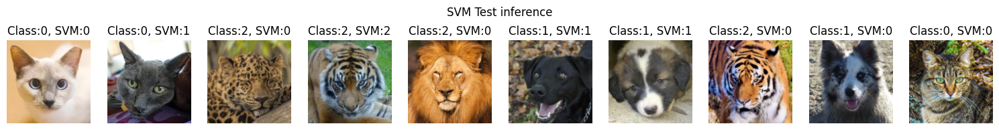

In [ ]:
bigan.post_inference(classifier='SVM',SVM_kernel='linear',pca=False, pca_components=80)

100%|██████████| 147/147 [00:08<00:00, 18.32it/s]
C:\Users\user\AppData\Roaming\Python\Python310\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Train Accuracy: 0.6979494190020505


C:\Users\user\AppData\Local\Temp\ipykernel_13328\3212717235.py:259: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()


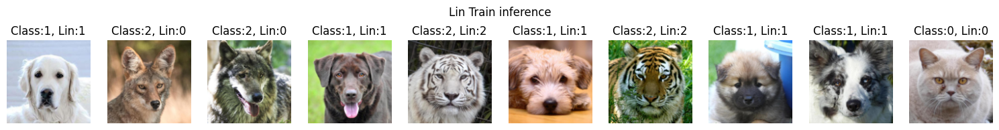

100%|██████████| 15/15 [00:01<00:00, 12.64it/s]
C:\Users\user\AppData\Local\Temp\ipykernel_13328\3212717235.py:302: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig2.tight_layout()


Test Accuracy: 0.6726666666666666


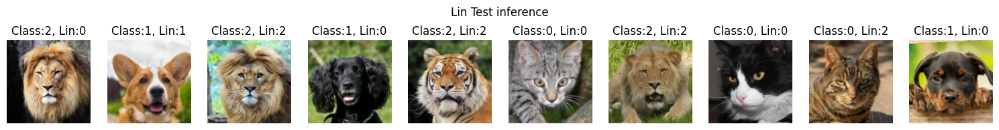

In [ ]:
bigan.post_inference(classifier='Lin',SVM_kernel='rbf',pca=False, pca_components=80)